<a href="https://www.kaggle.com/code/abdalrhamnhebishy/breast-cancer-acc-98?scriptVersionId=195625345" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
from IPython.core.display import HTML
# Apply styles globally within the notebook
HTML('''
<style>
  h2 {
    font-size: var(--j3p-content-font-size4);
    background-color:#FFDEAD  ;
    color: white;
    display: flex;
    align-items: center;
    justify-content: center;
    padding: 10px 41px;
    top: 10px;
    position: relative;
    border-radius: 10px 50px 10px 50px;
}

 img {       /* flex-grow: 1; */
            /* flex-shrink: 1; */
            border-radius: 100px 70px 150px 70px; 
            border: 10px solid #eee;
            display: flex;
            align-items: center;
            justify-content: center;
            transition: box-shadow 0.3s ease; /* Add a transition for a smooth effect */
        }

       img:active {
          box-shadow: 0 10px 20px rgba(255, 255, 0, 0.5), 0 6px 6px rgba(215, 215, 0, 0.5);
        }
</style>
''') 



## Breast Cancer Prediction  


<img src="https://images.everydayhealth.com/images/seo-graphic-content-initiative/eh-how-metastatic-breast-cancer-affects-the-body-seo-graphics-gs.png?sfvrsn=28fb2dbb_3" alt="My Image">

<img src="https://images.everydayhealth.com/images/seo-graphic-content-initiative/select--signs-that-metastatic-breast-cancer-has-spread-to-your-bones-.png?sfvrsn=add2291c_5" alt="My Image">

## Table of Contents 

<div style="border: 5px solid yellow; padding: 10px; background-color: #FFEFD5; color: black; border-radius: 30px 45px 30px 45px;">

   
    
    
<p> &bull;        <a target="_blank"> Introudction</a>  </p> 

<p> &bull;      <a target="_blank"> Explantory Data Analysis</a>  </p>

<p>&bull;       <a target="_blank"> Data Processing</a>  </p>

<p>&bull;       <a target="_blank"> Model Bulding</a> </p>   
    
<p>&bull;       <a target="_blank"> Evalution Metrics </a> </p> 

<p>&bull;       <a target="_blank"> Results & see the best models </a> </p>   

</div>

## Data Information

<div style="border: 5px solid yellow; padding: 10px; background-color: #FFEFD5; color: black; border-radius: 30px 45px 30px 45px;">

   
<p> &bull;Features are computed from a digitized image of a fine needle aspirate (FNA) of a breast mass. </p> 

<p> &bull;They describe characteristics of the cell nuclei .  </p>


</div>

## Dataset Features

| Variable      | Description                                                                                                 |
| ------------- | ----------------------------------------------------------------------------------------------------------- |
| ID number            | Number of  paient                                                                                       |
| Diagnosis          | (M = malignant, B = benign)                                                                                       |
| radius                      | (mean of distances from center to points on the perimeter)                                                                              |
| texture           | (standard deviation of gray-scale values                                                                                          |
| perimeter               |                                                                                 |
| area        |                                                                              |
| smoothness               | (local variation in radius lengths)                                                                                  |
| compactness           |  (perimeter^2 / area - 1.0                                                                           |
| concavity            |  (severity of concave portions of the contour)                                                                    |
| concave points             |  (number of concave portions of the contour)                                                                  |
| fractal dimension            | (coastline approximation - 1)                                                                     |                     
| Still There Are other Features            |                                                                    |    
                                             

## Understand the problem :

<div style="border: 5px solid yellow; padding: 10px; background-color: #FFEFD5; color: black; border-radius: 30px 45px 30px 45px;">







<p> &bull; This problem Consider as Binary Classification   .</p> 

<p> &bull; Target of this problem to predict & Classify breast cancer tumors as malignant (1 or 0)  .</p> 

<p> &bull; I will Train 5 models for Machine learning with visualization of them. (K-Nearest Neighbors (KNN),Random ForestClassiﬁer,Decision Tree Classiﬁer, Logistic Regression,Naive Bayes)  .</p> 

<p> &bull; Also i will Train Artifical Neural Network model (ANNs) and Evalution Metrics for it . </p>

<p>&bull; Also i will Make Explanory Analysis for the Data By using both SQL & Pandas  </p>

<p>&bull; Also i will learn the Relations between the Feature to  Make Different Plots that Represent the Data  </p>   
    
</div>

##  Import Libararies 

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler,OneHotEncoder,LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.base import BaseEstimator , TransformerMixin
from sklearn.feature_selection import VarianceThreshold ,f_classif ,SelectKBest
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import VotingClassifier
from sklearn import metrics
from sklearn.metrics import accuracy_score, mean_squared_error, r2_score, confusion_matrix, classification_report
from sklearn.metrics import mean_squared_error
from sklearn import tree
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.naive_bayes import GaussianNB
from sklearn.impute import SimpleImputer
import sqlite3
from plotly.graph_objs import *
import plotly.express as px 

In [3]:
# load the Data:

data=pd.read_csv("data.csv")
data.head(15)


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.26540,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.18600,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.24300,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.25750,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.16250,0.2364,0.07678,NaN
5,843786,M,12.45,15.70,82.57,477.1,0.12780,0.17000,0.15780,0.08089,...,23.75,103.40,741.6,0.1791,0.5249,0.5355,0.17410,0.3985,0.12440,NaN
6,844359,M,18.25,19.98,119.60,1040.0,0.09463,0.10900,0.11270,0.07400,...,27.66,153.20,1606.0,0.1442,0.2576,0.3784,0.19320,0.3063,0.08368,NaN
7,84458202,M,13.71,20.83,90.20,577.9,0.11890,0.16450,0.09366,0.05985,...,28.14,110.60,897.0,0.1654,0.3682,0.2678,0.15560,0.3196,0.11510,NaN
8,844981,M,13.00,21.82,87.50,519.8,0.12730,0.19320,0.18590,0.09353,...,30.73,106.20,739.3,0.1703,0.5401,0.5390,0.20600,0.4378,0.10720,NaN
9,84501001,M,12.46,24.04,83.97,475.9,0.11860,0.23960,0.22730,0.08543,...,40.68,97.65,711.4,0.1853,1.0580,1.1050,0.22100,0.4366,0.20750,NaN


## Explore the Data 

In [4]:
#get info about the dataset:
print(data.info())
print("-"*25)
# to know more about the shape of the dataset:
print("shape of the dataset -->>",np.shape(data))


<class 'pandas.core.frame.DataFrame'>

RangeIndex: 569 entries, 0 to 568

Data columns (total 33 columns):

 #   Column                   Non-Null Count  Dtype  

---  ------                   --------------  -----  

 0   id                       569 non-null    int64  

 1   diagnosis                569 non-null    object 

 2   radius_mean              569 non-null    float64

 3   texture_mean             569 non-null    float64

 4   perimeter_mean           569 non-null    float64

 5   area_mean                569 non-null    float64

 6   smoothness_mean          569 non-null    float64

 7   compactness_mean         569 non-null    float64

 8   concavity_mean           569 non-null    float64

 9   concave points_mean      569 non-null    float64

 10  symmetry_mean            569 non-null    float64

 11  fractal_dimension_mean   569 non-null    float64

 12  radius_se                569 non-null    float64

 13  texture_se               569 non-null    float64

 14  perimet

In [5]:
#get the statistical:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
id,569.0,3.037183e+07,1.250206e+08,8670.000000,869218.000000,906024.000000,8.813129e+06,9.113205e+08
radius_mean,569.0,1.412729e+01,3.524049e+00,6.981000,11.700000,13.370000,1.578000e+01,2.811000e+01
texture_mean,569.0,1.928965e+01,4.301036e+00,9.710000,16.170000,18.840000,2.180000e+01,3.928000e+01
perimeter_mean,569.0,9.196903e+01,2.429898e+01,43.790000,75.170000,86.240000,1.041000e+02,1.885000e+02
area_mean,569.0,6.548891e+02,3.519141e+02,143.500000,420.300000,551.100000,7.827000e+02,2.501000e+03
smoothness_mean,569.0,9.636028e-02,1.406413e-02,0.052630,0.086370,0.095870,1.053000e-01,1.634000e-01
compactness_mean,569.0,1.043410e-01,5.281276e-02,0.019380,0.064920,0.092630,1.304000e-01,3.454000e-01
concavity_mean,569.0,8.879932e-02,7.971981e-02,0.000000,0.029560,0.061540,1.307000e-01,4.268000e-01
concave points_mean,569.0,4.891915e-02,3.880284e-02,0.000000,0.020310,0.033500,7.400000e-02,2.012000e-01
symmetry_mean,569.0,1.811619e-01,2.741428e-02,0.106000,0.161900,0.179200,1.957000e-01,3.040000e-01


In [6]:
# get Types of features:

data.dtypes

id                           int64
diagnosis                   object
radius_mean                float64
texture_mean               float64
perimeter_mean             float64
area_mean                  float64
smoothness_mean            float64
compactness_mean           float64
concavity_mean             float64
concave points_mean        float64
symmetry_mean              float64
fractal_dimension_mean     float64
radius_se                  float64
texture_se                 float64
perimeter_se               float64
area_se                    float64
smoothness_se              float64
compactness_se             float64
concavity_se               float64
concave points_se          float64
symmetry_se                float64
fractal_dimension_se       float64
radius_worst               float64
texture_worst              float64
perimeter_worst            float64
area_worst                 float64
smoothness_worst           float64
compactness_worst          float64
concavity_worst     

In [7]:
# know the number of every item in every column:

for col in data.columns:
    print(f"counts of items in {col} -->> \n {data[col].value_counts()}")
    print("-"*25)

counts of items in id -->> 

 id

842302     1

90250      1

901315     1

9013579    1

9013594    1

          ..

873885     1

873843     1

873701     1

873593     1

92751      1

Name: count, Length: 569, dtype: int64

-------------------------

counts of items in diagnosis -->> 

 diagnosis

B    357

M    212

Name: count, dtype: int64

-------------------------

counts of items in radius_mean -->> 

 radius_mean

12.34    4

11.71    3

12.46    3

13.05    3

10.26    3

        ..

12.23    1

14.45    1

19.18    1

18.08    1

7.76     1

Name: count, Length: 456, dtype: int64

-------------------------

counts of items in texture_mean -->> 

 texture_mean

20.52    3

16.85    3

16.84    3

19.83    3

14.93    3

        ..

18.58    1

15.11    1

22.41    1

14.92    1

24.54    1

Name: count, Length: 479, dtype: int64

-------------------------

counts of items in perimeter_mean -->> 

 perimeter_mean

82.61     3

87.76     3

134.70    3

93.97     2

82.69    

In [8]:
# to know the uniques values in evey column in the dataset:
for col in data.columns:
    print(f"All items in the ---->>>{col} column  :  \n{data[col].unique()}")
    print("*"*50)

All items in the ---->>>id column  :  

[   842302    842517  84300903  84348301  84358402    843786    844359

  84458202    844981  84501001    845636  84610002    846226    846381

  84667401  84799002    848406  84862001    849014   8510426   8510653

   8510824   8511133    851509    852552    852631    852763    852781

    852973    853201    853401    853612  85382601    854002    854039

    854253    854268    854941    855133    855138    855167    855563

    855625    856106  85638502    857010  85713702     85715    857155

    857156    857343    857373    857374    857392    857438  85759902

    857637    857793    857810    858477    858970    858981    858986

    859196  85922302    859283    859464    859465    859471    859487

    859575    859711    859717    859983   8610175   8610404   8610629

   8610637   8610862   8610908    861103   8611161   8611555   8611792

   8612080   8612399  86135501  86135502    861597    861598    861648

    861799    861853    

In [9]:
# Extract all Types of columns from the data :
for col in data.columns:
    obj_cols=data.select_dtypes("object").columns

    num_cols=data.select_dtypes("number").columns

    disc_cols=data.select_dtypes(include=("int64")).columns

    conts_cols=data.select_dtypes(include=("float64")).columns

    Nomial_cols=data.nunique()[data.nunique()<3]

print(f"object_columns ----->>> {obj_cols}\n Numerical_columns ----->>> {num_cols} \n Discrete_columns ---->>> {disc_cols} \n Continous_cols ----->> {conts_cols} \n Nominal Columns --->> {Nomial_cols}")

object_columns ----->>> Index(['diagnosis'], dtype='object')

 Numerical_columns ----->>> Index(['id', 'radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',

       'smoothness_mean', 'compactness_mean', 'concavity_mean',

       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',

       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',

       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',

       'fractal_dimension_se', 'radius_worst', 'texture_worst',

       'perimeter_worst', 'area_worst', 'smoothness_worst',

       'compactness_worst', 'concavity_worst', 'concave points_worst',

       'symmetry_worst', 'fractal_dimension_worst', 'Unnamed: 32'],

      dtype='object') 

 Discrete_columns ---->>> Index(['id'], dtype='object') 

 Continous_cols ----->> Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',

       'smoothness_mean', 'compactness_mean', 'concavity_mean',

       'concave points_mean', 

## Cleaning :














<div style="border: 5px solid yellow; padding: 10px; background-color: #FFEFD5; color: black; border-radius: 30px 45px 30px 45px;">

<p> &bull; At First i checked if ound any Null Values . </p> 

<p> &bull; Also i Removed unless columns like ID  . </p>

<p> &bull; I checked Duplicates values & Remove it if ound . </p>

<p> &bull; I removed Structure null values  </p>

<p> &bull; I used the Simple Imputer Method to fill the Null Values . </p> 

<p> &bull; I used median Strategy with Numerical Features  .</p> 

<p> &bull; I make Reshape , then i make squeeze on it  . </p>

<p> &bull; Any Column , Rate of missing values Reach above 75% ,Delete it  . </p>
</div>

## Cleaning  The Data & Remove the unless Features :

In [10]:
# check the Null Values :
# ok there no Any Null values :
data.isna().mean()

id                         0.0
diagnosis                  0.0
radius_mean                0.0
texture_mean               0.0
perimeter_mean             0.0
area_mean                  0.0
smoothness_mean            0.0
compactness_mean           0.0
concavity_mean             0.0
concave points_mean        0.0
symmetry_mean              0.0
fractal_dimension_mean     0.0
radius_se                  0.0
texture_se                 0.0
perimeter_se               0.0
area_se                    0.0
smoothness_se              0.0
compactness_se             0.0
concavity_se               0.0
concave points_se          0.0
symmetry_se                0.0
fractal_dimension_se       0.0
radius_worst               0.0
texture_worst              0.0
perimeter_worst            0.0
area_worst                 0.0
smoothness_worst           0.0
compactness_worst          0.0
concavity_worst            0.0
concave points_worst       0.0
symmetry_worst             0.0
fractal_dimension_worst    0.0
Unnamed:

In [11]:
# change name of column Unnamed: 32 into Unnamed :
data.rename(columns={'Unnamed: 32': 'Unnamed'}, inplace=True)

# Remove unless Columns & Columns with missing values :
data = data.drop(columns=["Unnamed", "id"], errors='ignore')
data.isna().sum()

diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64

In [12]:
# Check if there are aduplicated values in the data & drop it if found :
df=data
duplicated_features=df.duplicated().sum()
print("Number of duplicates ----->>> ",duplicated_features)
df = df.drop_duplicates()
duplicated_features=df.duplicated().sum()
print("Number of duplicates of cleaning it ----->>> ",duplicated_features)

Number of duplicates ----->>>  0

Number of duplicates of cleaning it ----->>>  0


In [13]:
# fill any null values if found  :

for col in data.select_dtypes("number").columns:
    imputer = SimpleImputer(missing_values=np.nan, strategy="median")
    imputed_values = imputer.fit_transform(data[col].values.reshape(-1, 1))
    data[col] = np.squeeze(imputed_values)
data

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


## SQL Analysis :

In [14]:
# Connect to the database
conn = sqlite3.connect('Cancer.db')

# Create a cursor object
cursor = conn.cursor()

# Check if the table 'insurance1' exists
cursor.execute("""
SELECT * FROM sqlite_master WHERE type='table' AND name='BC';
""")
table_exists = cursor.fetchone()

# Create the table only if it does not exist
if not table_exists:
    # Assuming 'data' is your pandas DataFrame
    data.to_sql("BC", conn, if_exists='fail')  # 'fail' will raise a ValueError if the table already exists
else:
    print("The table 'BC' already exists. Skipping table creation.")

The table 'BC' already exists. Skipping table creation.


In [15]:
df = pd.read_sql("SELECT * FROM BC", conn)
df.drop(columns="index",axis=1)

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


## SQL Queries :














<div style="border: 5px solid yellow; padding: 10px; background-color: #FFEFD5; color: black; border-radius: 30px 45px 30px 45px;">

<p> &bull; I make some Queries to Deep more into the Data to Answer on the Client Questions. </p> 

<p> &bull; Also i used it As There Some Complex Questions that i cant Answer it using Pandas  .</p> 

<p> &bull; Finally , I used it As it Extract Answers from the Relational Questions   .</p> 


</div>

In [16]:
# Q1: how many of malignant Tumor That radius_mean & texture_mean bigger than 20 ?   :

print("=== Number OF malignant Tumor That radius_mean & texture_mean bigger than 20 === ")
R1=cursor.execute("SELECT COUNT(DIAGNOSIS) FROM BC  WHERE   DIAGNOSIS='M' AND TEXTURE_MEAN >20 AND RADIUS_MEAN > 20  ")
print(R1.fetchall())
print("-"*50)


# Q2: how many of  malignant Tumor That area_mean between 181 & 1326   ?

print("===  Number malignant Tumor That area_mean  between 181 & 1326  === ")
R2=cursor.execute("SELECT COUNT(DIAGNOSIS) FROM BC  WHERE DIAGNOSIS='M' AND AREA_MEAN BETWEEN 181.0	AND 1326.0 ")
print(R2.fetchall())






=== Number OF malignant Tumor That radius_mean & texture_mean bigger than 20 === 

[(34,)]

--------------------------------------------------

===  Number malignant Tumor That area_mean  between 181 & 1326  === 

[(187,)]


## Explantory on Dataset: 




<div style="border: 5px solid yellow; padding: 10px; background-color: #FFEFD5; color: black; border-radius: 30px 45px 30px 45px;">

<p> &bull; Contex : </p> 

<p> &bull; Correlation : I make correlation to study Relations between features </p> 

<p> &bull; outliers : Defination outliers and check on each feature   .</p> 

<p> &bull; Anova , i make some Stastical Anova test  .</p> 

<p> &bull; heatmap : very strong plot that show the Strong / week Relations between features   .</p> 
</div>

In [17]:
# VaraianceThreshold:
selector=VarianceThreshold(threshold=0.01)
selector.fit(data.select_dtypes("number"))

VarianceThreshold(threshold=0.01)

In [18]:
class Var_Selector(BaseEstimator,TransformerMixin):

    def __init__(self,num_cols):
        self.num_cols=None
    def fit(self,data):
        self.num_cols=data.select_dtypes("number").columns
        return self
    def transform(self,data):
        selector=VarianceThreshold(threshold=0.01)
        selector.fit(data[self.num_cols])

        removed_cols=[column for column in self.num_cols if column not in \
                     self.num_cols[selector.get_support(indices=True)]]
        data=data.drop(columns=removed_cols)

        # remove high-low cardinality categorical:-

        removed_cols=data.nunique()[((data.nunique()==1)|data.nunique()==len(data))].index

        return data.drop(columns=removed_cols)

In [19]:
transform=Var_Selector(data)
transform.fit_transform(data)

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,radius_se,texture_se,perimeter_se,area_se,radius_worst,texture_worst,perimeter_worst,area_worst,compactness_worst,concavity_worst
0,M,17.99,10.38,122.80,1001.0,1.0950,0.9053,8.589,153.40,25.380,17.33,184.60,2019.0,0.66560,0.7119
1,M,20.57,17.77,132.90,1326.0,0.5435,0.7339,3.398,74.08,24.990,23.41,158.80,1956.0,0.18660,0.2416
2,M,19.69,21.25,130.00,1203.0,0.7456,0.7869,4.585,94.03,23.570,25.53,152.50,1709.0,0.42450,0.4504
3,M,11.42,20.38,77.58,386.1,0.4956,1.1560,3.445,27.23,14.910,26.50,98.87,567.7,0.86630,0.6869
4,M,20.29,14.34,135.10,1297.0,0.7572,0.7813,5.438,94.44,22.540,16.67,152.20,1575.0,0.20500,0.4000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,M,21.56,22.39,142.00,1479.0,1.1760,1.2560,7.673,158.70,25.450,26.40,166.10,2027.0,0.21130,0.4107
565,M,20.13,28.25,131.20,1261.0,0.7655,2.4630,5.203,99.04,23.690,38.25,155.00,1731.0,0.19220,0.3215
566,M,16.60,28.08,108.30,858.1,0.4564,1.0750,3.425,48.55,18.980,34.12,126.70,1124.0,0.30940,0.3403
567,M,20.60,29.33,140.10,1265.0,0.7260,1.5950,5.772,86.22,25.740,39.42,184.60,1821.0,0.86810,0.9387


In [20]:
# Calculate the correlation :

corr=data.select_dtypes("number").corr()
corr

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
radius_mean,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,-0.311631,...,0.969539,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066
texture_mean,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,-0.076437,...,0.352573,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205
perimeter_mean,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,-0.261477,...,0.969476,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019
area_mean,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,-0.283110,...,0.962746,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738
smoothness_mean,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,0.584792,...,0.213120,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316
compactness_mean,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,0.602641,0.565369,...,0.535315,0.248133,0.590210,0.509604,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382
concavity_mean,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,0.500667,0.336783,...,0.688236,0.299879,0.729565,0.675987,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930
concave points_mean,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,0.462497,0.166917,...,0.830318,0.292752,0.855923,0.809630,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661
symmetry_mean,0.147741,0.071401,0.183027,0.151293,0.557775,0.602641,0.500667,0.462497,1.000000,0.479921,...,0.185728,0.090651,0.219169,0.177193,0.426675,0.473200,0.433721,0.430297,0.699826,0.438413
fractal_dimension_mean,-0.311631,-0.076437,-0.261477,-0.283110,0.584792,0.565369,0.336783,0.166917,0.479921,1.000000,...,-0.253691,-0.051269,-0.205151,-0.231854,0.504942,0.458798,0.346234,0.175325,0.334019,0.767297


Text(0.5, 1.0, 'Correlation_heatmap_Matrix')

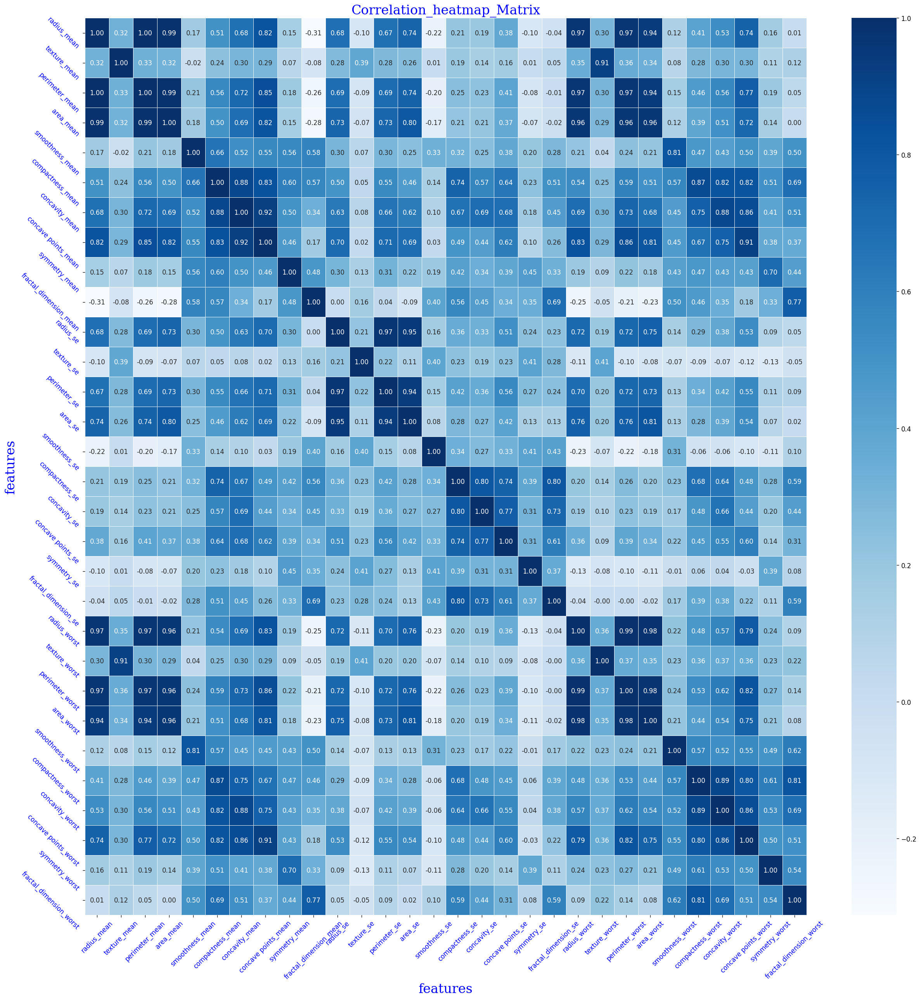

In [21]:
# plot the heatmap:
# plot the heatmap_Correlation_MatRix:
f1={"family":"serif","size":20,"color":"b"}
plt.figure(figsize=(25,25),dpi=120)
sns.heatmap(data.select_dtypes("number").corr(),annot=True,fmt="0.2f",cmap='Blues',linewidths=0.5)
plt.xticks(rotation=45,color="b")
plt.yticks(rotation=-45,color="b")
plt.xlabel("features",fontdict=f1)
plt.ylabel("features",fontdict=f1)
plt.title("Correlation_heatmap_Matrix",fontdict=f1)

## Defination Outliers :

In [22]:
# found many feature contain the outliers  :
features=data.select_dtypes(include="number").columns

for col in features:
    Q1_col,Q3_col=data[col].quantile([0.25,0.75])
    iqr=Q3_col-Q1_col
    low_limit=Q1_col-1.5*iqr
    upper_limit=Q3_col+1.5*iqr
    outlier=[]
    for x in data[col]:
         if ((x> upper_limit) or (x<low_limit)):
             outlier.append(x)
    if len(outlier)==0:
        print(f" * -- >> there No outlier in {col} feature")
    else:
        print(f"Ther outlier in this feature {col}")

    print(f"Q1 of {col} --->>> {Q1_col} \n Q3 of {col} ---->>> {Q3_col} \n iqr--->>{iqr}\n low_limit--->>>{low_limit} \n  upper_limit--->>> {upper_limit} \n outlier---->>> {outlier} \n Number of outliers --->>> {len(outlier)}")
    print("-"*25)

Ther outlier in this feature radius_mean

Q1 of radius_mean --->>> 11.7 

 Q3 of radius_mean ---->>> 15.78 

 iqr--->>4.08

 low_limit--->>>5.579999999999999 

  upper_limit--->>> 21.9 

 outlier---->>> [25.22, 22.27, 24.25, 23.27, 27.22, 23.29, 28.11, 23.21, 23.51, 25.73, 22.01, 27.42, 23.09, 24.63] 

 Number of outliers --->>> 14

-------------------------

Ther outlier in this feature texture_mean

Q1 of texture_mean --->>> 16.17 

 Q3 of texture_mean ---->>> 21.8 

 iqr--->>5.629999999999999

 low_limit--->>>7.725000000000003 

  upper_limit--->>> 30.244999999999997 

 outlier---->>> [32.47, 33.81, 39.28, 33.56, 31.12, 30.72, 30.62] 

 Number of outliers --->>> 7

-------------------------

Ther outlier in this feature perimeter_mean

Q1 of perimeter_mean --->>> 75.17 

 Q3 of perimeter_mean ---->>> 104.1 

 iqr--->>28.929999999999993

 low_limit--->>>31.775000000000013 

  upper_limit--->>> 147.49499999999998 

 outlier---->>> [171.5, 152.8, 166.2, 152.1, 182.1, 158.9, 188.5, 153.

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


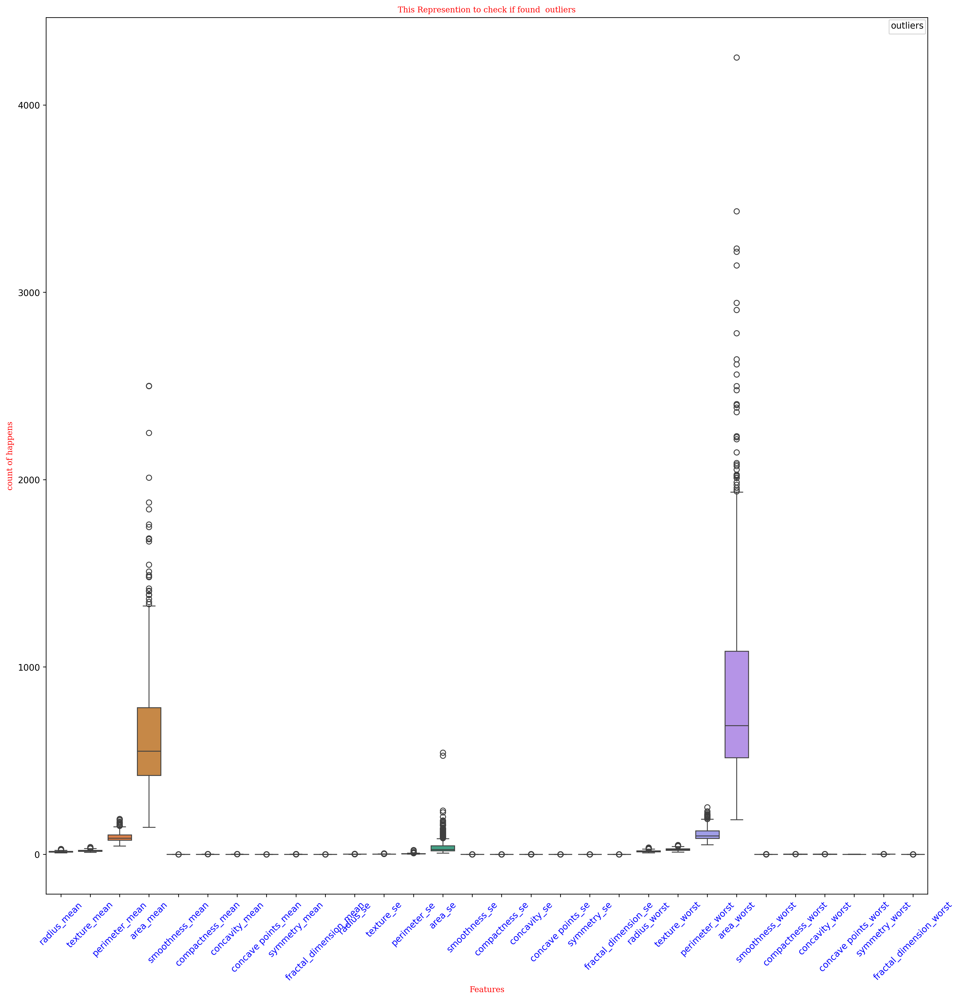

In [23]:
# from this Represention we discover that we found outliers :
f1={"family":"serif","size":9,"color":"r"}
plt.figure(figsize=(18,18),dpi=250)
plt.title("This Represention to check if found  outliers",fontdict=f1)
plt.xlabel("Features",fontdict=f1)
plt.ylabel("count of happens",fontdict=f1)
plt.xticks(rotation=45,color="b")
sns.boxplot(data[features])
plt.legend(title="outliers",prop={'size': 5})

upper_limit :  164.86597650818038

lower_limit :  19.072090275650922

Mean Value :  91.96903339191564

Median Value :  86.24

1st Standard Deviation :  24.298981038754906


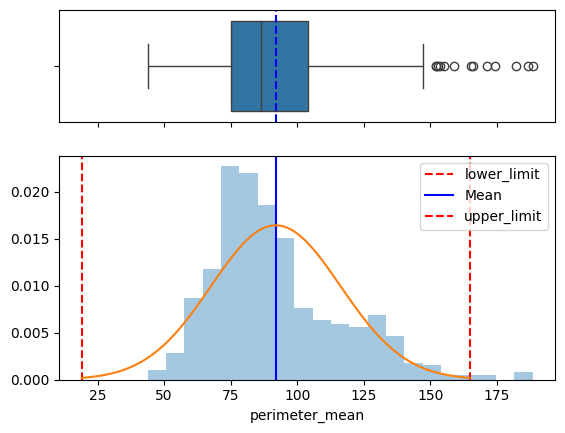

In [24]:
#calculate outlier on perimeter_mean feature:-
# We can see that Distibution in this feature follow Standard Normal Distribution N -> (0,1)

from scipy.stats import norm
import warnings
warnings.filterwarnings('ignore')

f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw= {"height_ratios": (0.5, 1)})

mean=data.perimeter_mean.mean()
std = data.perimeter_mean.std()
median = data.perimeter_mean.median()
upper_limit = mean + std*3
lower_limit = mean - std*3
print("upper_limit : ", upper_limit)
print("lower_limit : ",lower_limit)

sns.boxplot(x=data["perimeter_mean"], ax=ax_box)
ax_box.axvline(mean, color='b', linestyle='--')


sns.distplot(data["perimeter_mean"], ax=ax_hist,kde=False,norm_hist=True)
ax_hist.axvline(lower_limit, color='r', linestyle='--')
ax_hist.axvline(mean, color='b', linestyle='-')
ax_hist.axvline(upper_limit, color='r', linestyle='--')



plt.legend({'Mean':mean})

ax_box.set(xlabel='')

x = np.linspace(mean - 3*std, mean + 3*std, 100)
plt.plot(x, norm.pdf(x, mean, std))
plt.legend({"lower_limit":lower_limit,'Mean':mean,'upper_limit':upper_limit})
print("Mean Value : ",mean)
print("Median Value : ",median)
print("1st Standard Deviation : ",std)

plt.show()

upper_limit :  0.08397869822708115

lower_limit :  0.041616521456574386

Mean Value :  0.06279760984182776

Median Value :  0.06154

1st Standard Deviation :  0.007060362795084459


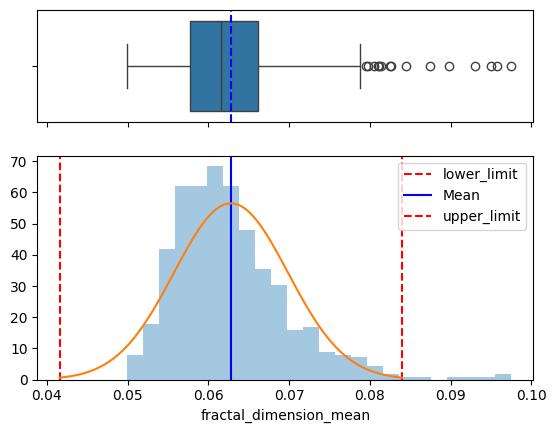

In [25]:
#calculate outlier on fractal_dimension_mean feature:-
# We can see that Distibution in this feature follow Standard Normal Distribution N -> (0,1)

from scipy.stats import norm
import warnings
warnings.filterwarnings('ignore')

f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw= {"height_ratios": (0.5, 1)})

mean=data.fractal_dimension_mean.mean()
std = data.fractal_dimension_mean.std()
median = data.fractal_dimension_mean.median()
upper_limit = mean + std*3
lower_limit = mean - std*3
print("upper_limit : ", upper_limit)
print("lower_limit : ",lower_limit)

sns.boxplot(x=data["fractal_dimension_mean"], ax=ax_box)
ax_box.axvline(mean, color='b', linestyle='--')


sns.distplot(data["fractal_dimension_mean"], ax=ax_hist,kde=False,norm_hist=True)
ax_hist.axvline(lower_limit, color='r', linestyle='--')
ax_hist.axvline(mean, color='b', linestyle='-')
ax_hist.axvline(upper_limit, color='r', linestyle='--')



plt.legend({'Mean':mean})

ax_box.set(xlabel='')

x = np.linspace(mean - 3*std, mean + 3*std, 100)
plt.plot(x, norm.pdf(x, mean, std))
plt.legend({"lower_limit":lower_limit,'Mean':mean,'upper_limit':upper_limit})
print("Mean Value : ",mean)
print("Median Value : ",median)
print("1st Standard Deviation : ",std)

plt.show()

## Visualization :

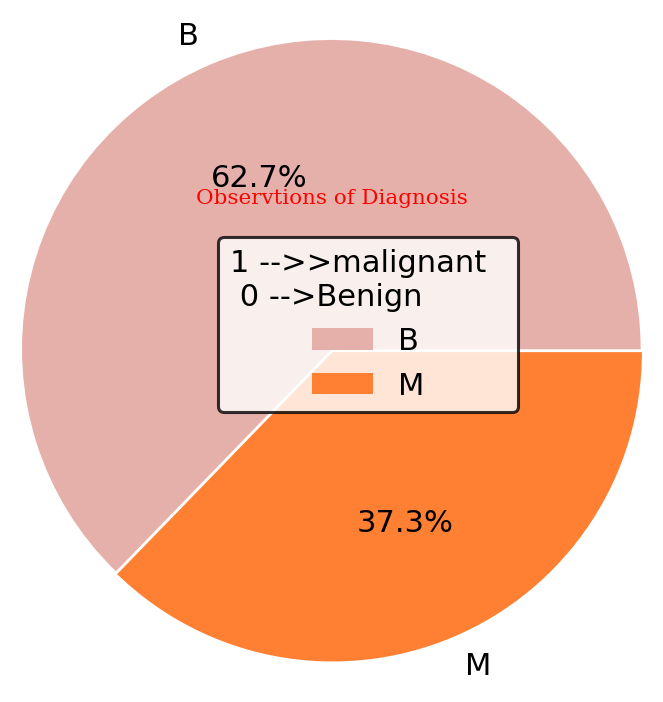

In [26]:
# Font style for titles
f1 = {"family": "serif", "size": 7, "color": "r"}

# Create a figure with a specified size and DPI
plt.figure(figsize=(7, 7), dpi=220)

# Create the first subplot
Outcome = data["diagnosis"].value_counts()


plt.subplot(4, 4, 1)  
plt.title("Observtions of Diagnosis", fontdict=f1)

# Plot the pie chart :
plt.pie(
    x=Outcome,  
    labels=Outcome.index,  
    colors=["#E6B0AA","#FF8033"],
    explode=[0.01, 0.02],
    autopct='%1.1f%%',
    radius=3,
)

plt.legend(loc='upper left', title="1 -->>malignant  \n 0 -->Benign ",facecolor='white', edgecolor='black')


## Waffle Visualization :














<div style="border: 5px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

<p> &bull; i Make Waffle observation to see which feature that Controlled on other Features . </p> 

<p> &bull; i found area_worst Feature controled on other features .</p> 

<p> &bull; Finally , area_worst Feature : is the most important Feature in the Data   .</p> 


</div>

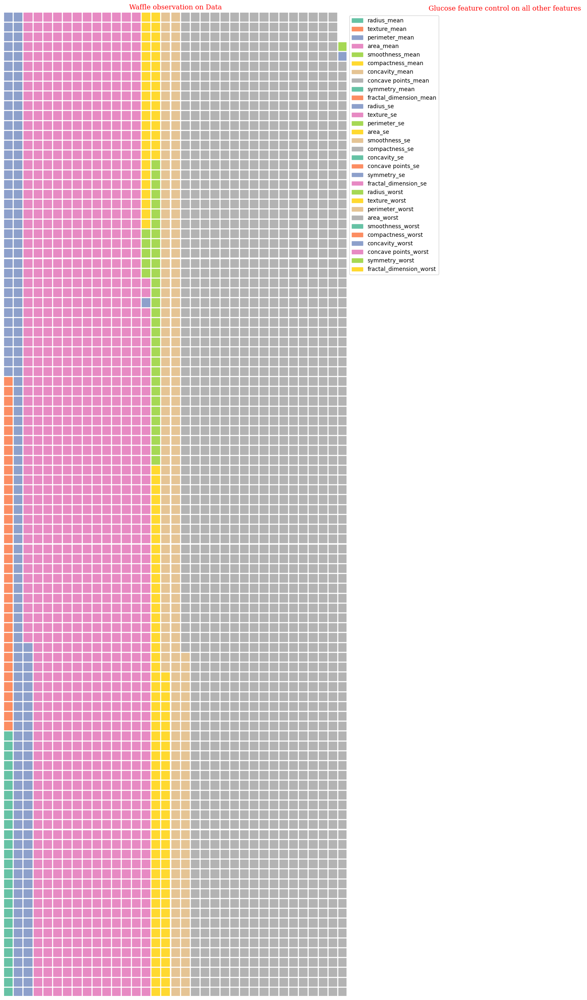

In [27]:
# Make a waffel for the Data:
# from this waffle i see which Feature is a controled on other features : 


f2 = {"family": "serif", "size": 12, "color": "r"}

from pywaffle import Waffle

numeric_columns = data.select_dtypes(include=['int64', 'float64']).columns
values = data[numeric_columns].sum().tolist()

fig = plt.figure(
    FigureClass=Waffle,
    rows=100,
    columns=35,
    values=values,
    legend={'labels': numeric_columns.tolist(),
            'loc': "upper left",
            'bbox_to_anchor': (1, 1)},
    figsize=(25, 25)
)
plt.title("Waffle observation on Data",fontdict=f2)
plt.suptitle("Glucose feature control on all other features ",fontdict=f2)
plt.show()

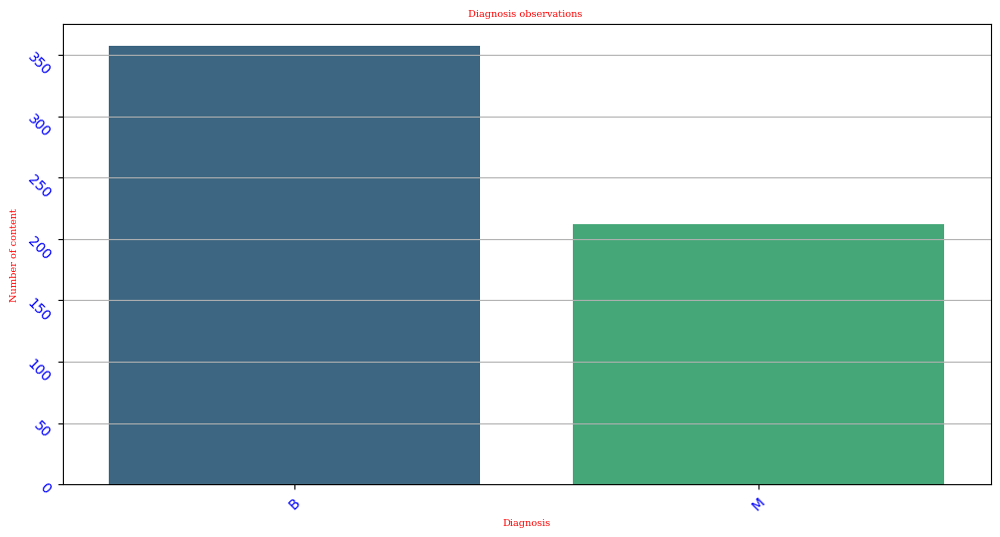

In [28]:
# plot the diagnosis  : 

color_palette = ['green', 'darkgreen']
diag = data['diagnosis'].value_counts().head(20)
plt.figure(figsize=(12, 6))
sns.barplot(x=diag.index, y=diag.values,hue=diag.index,palette="viridis")
plt.title('Diagnosis observations ',fontdict=f1)
plt.xlabel('Diagnosis',fontdict=f1)
plt.ylabel('Number of content',fontdict=f1)
plt.grid(True, axis='y')
plt.xticks(rotation=45,color="b")
plt.yticks(rotation=-45,color="b")
plt.show()

## lineplot Visualization :














<div style="border: 2px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

<p> &bull; i used lineplots to make visualizaion between features & Study Relationships between them . </p> 

<p> &bull; Also to Detect the Power of this Relation (Positve /Negative) .</p> 

<p> &bull; i used ordered least squares in trendline to detect this    .</p> 


</div>

Type of Relation : weak positve RelationShip


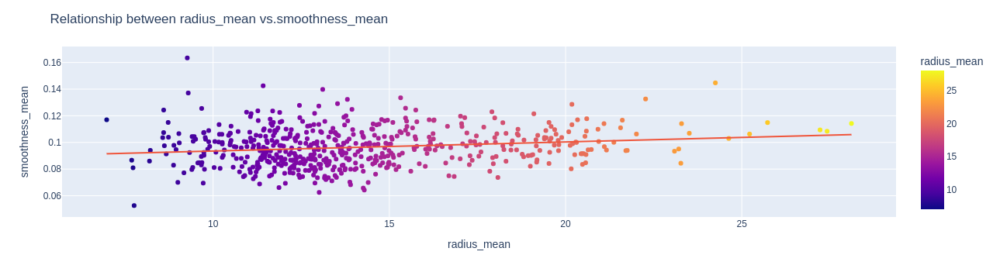

Type of Relation : Strong positve RelationShip


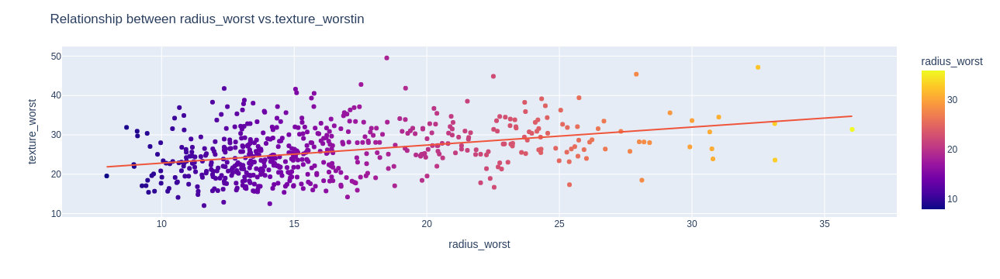

In [29]:
print("Type of Relation : weak positve RelationShip")

#Create lineplot Observation radius_mean vs.smoothness_mean
fig = px.scatter(data, x='radius_mean', y='smoothness_mean', color='radius_mean', color_discrete_sequence=color_palette,trendline='ols')
# Update the layout
fig.update_layout(title="Relationship between radius_mean vs.smoothness_mean ", xaxis_title="radius_mean", yaxis_title="smoothness_mean")
# Show the figure
fig.show()



print("Type of Relation : Strong positve RelationShip")
#Create lineplot Observation radius_worst vs.texture_worst
fig = px.scatter(data, x='radius_worst', y='texture_worst', color='radius_worst', color_discrete_sequence=color_palette,trendline='ols')
# Update the layout
fig.update_layout(title="Relationship between radius_worst vs.texture_worstin ", xaxis_title="radius_worst", yaxis_title="texture_worst")
# Show the figure
fig.show()




Type of Relation : Strong positve RelationShip


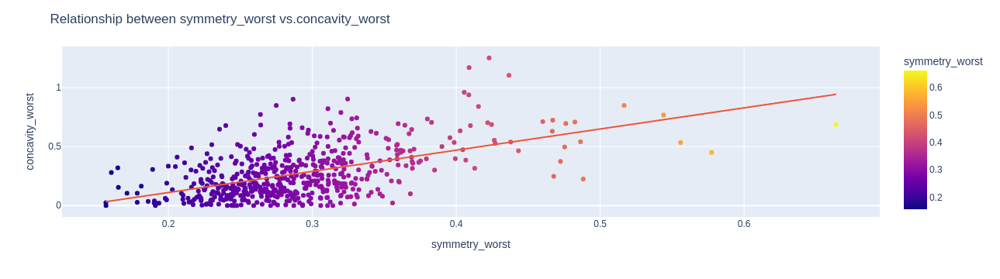

Type of Relation : Strong positve RelationShip


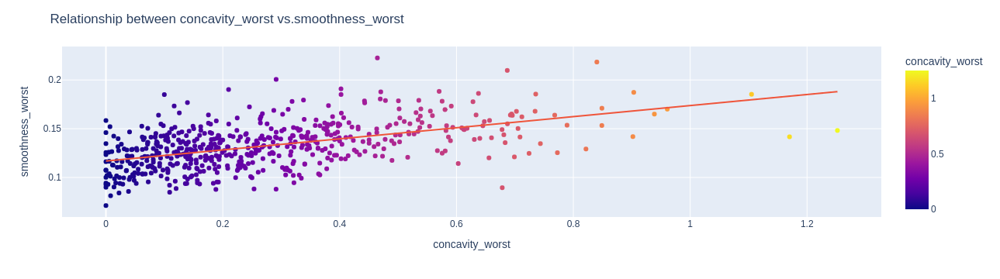

In [30]:
print("Type of Relation : Strong positve RelationShip")

#Create lineplot Observation symmetry_worst vs.concavity_worst

fig = px.scatter(data, x='symmetry_worst', y='concavity_worst', color='symmetry_worst', color_discrete_sequence=color_palette,trendline='ols')
# Update the layout
fig.update_layout(title="Relationship between symmetry_worst vs.concavity_worst ", xaxis_title="symmetry_worst", yaxis_title="concavity_worst")
# Show the figure
fig.show()


print("Type of Relation : Strong positve RelationShip")

#Create lineplot Observation concavity_worst vs.smoothness_worst

fig = px.scatter(data, x='concavity_worst', y='smoothness_worst', color='concavity_worst', color_discrete_sequence=color_palette,trendline='ols')
# Update the layout
fig.update_layout(title="Relationship between concavity_worst vs.smoothness_worst", xaxis_title="concavity_worst", yaxis_title="smoothness_worst")
# Show the figure
fig.show()

## Histogram Visualization :














<div style="border: 5px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

<p> &bull; i used Histogram on the Numerical Data Features </p> 

<p> &bull; We can see in this plots how data show  .</p> 

</div>

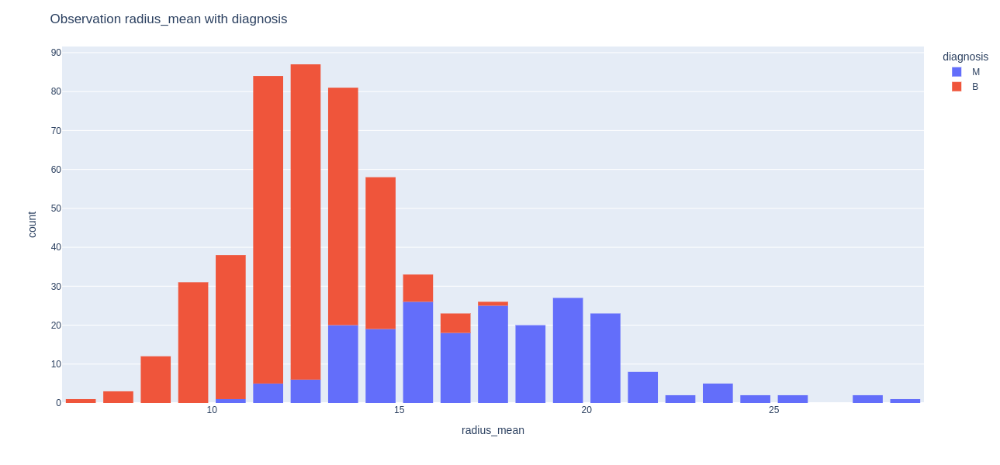

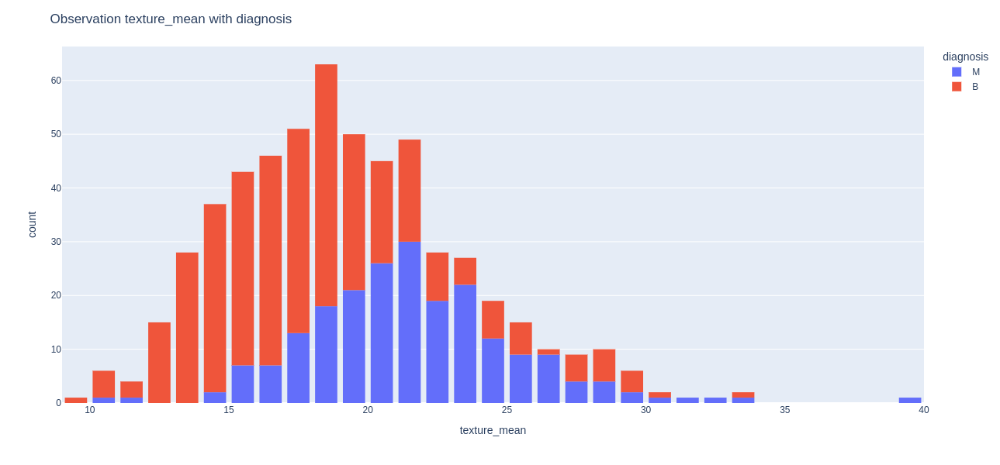

In [31]:
# Histogram that show how radius_mean feature liked with diagnosis :
fig = px.histogram(data, x="radius_mean", color="diagnosis")
fig.update_layout(
    bargap=0.2,
    title="Observation radius_mean with diagnosis ",
    legend_title="diagnosis",
    width=800,  
    height=600  
)
fig.show()

# Here also you can see how texture_mean feature liked with diagnosis 
fig = px.histogram(data, x="texture_mean", color="diagnosis")
fig.update_layout(
    bargap=0.2,
    title="Observation texture_mean with diagnosis ",
    legend_title="diagnosis",
    width=800,  
    height=600  
)
fig.show()


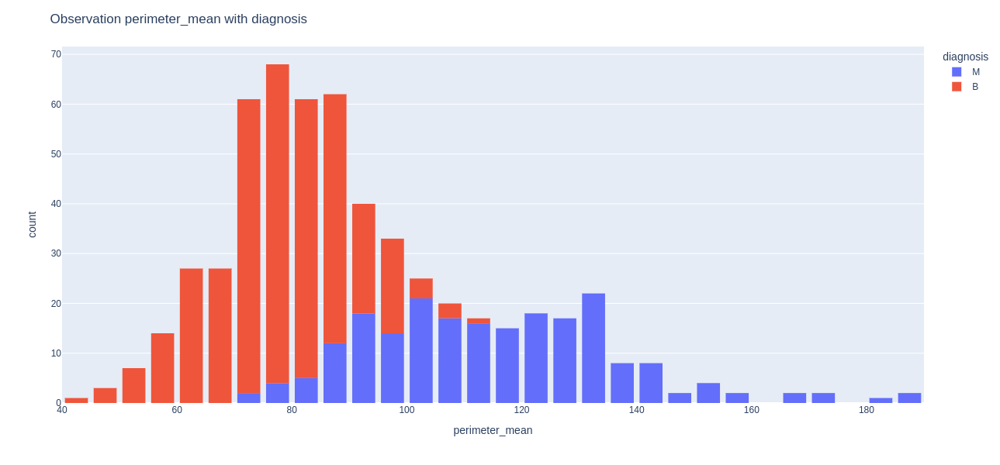

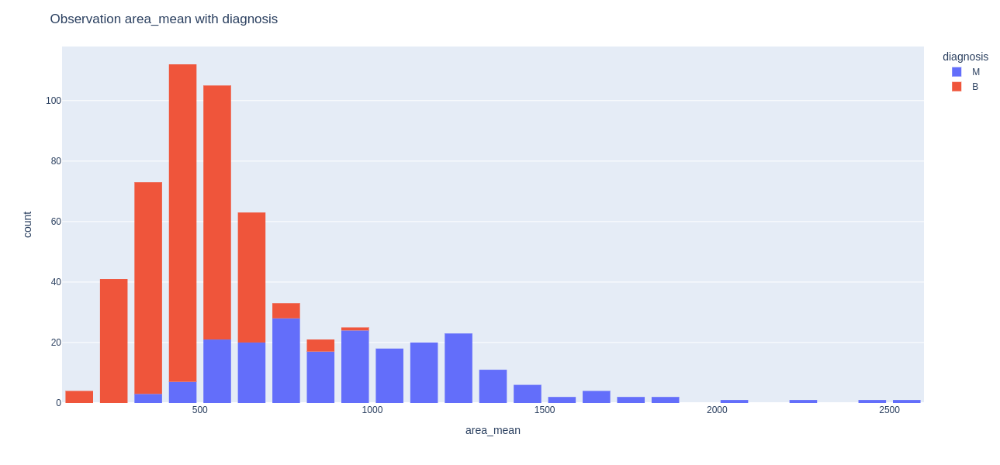

In [32]:
# Here also you can see how perimeter_mean feature liked with diagnosis 
fig = px.histogram(data, x="perimeter_mean", color="diagnosis")
fig.update_layout(
    bargap=0.2,
    title="Observation perimeter_mean with diagnosis ",
    legend_title="diagnosis",
    width=800,  
    height=600  
)
fig.show()

# Here also you can see how area_mean feature liked with diagnosis 
fig = px.histogram(data, x="area_mean", color="diagnosis")
fig.update_layout(
    bargap=0.2,
    title="Observation area_mean with diagnosis ",
    legend_title="diagnosis",
    width=800,  
    height=600  
)
fig.show()

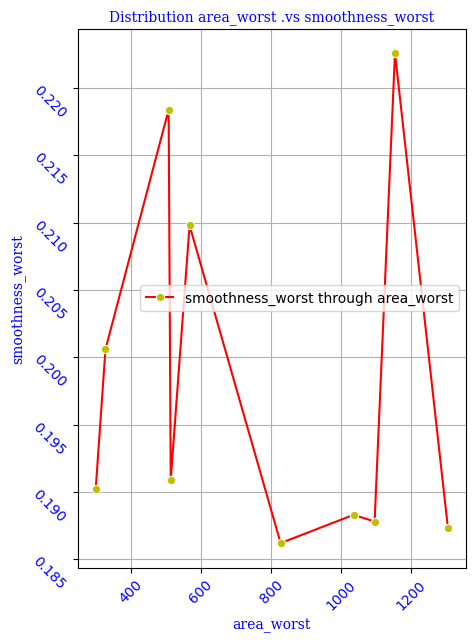

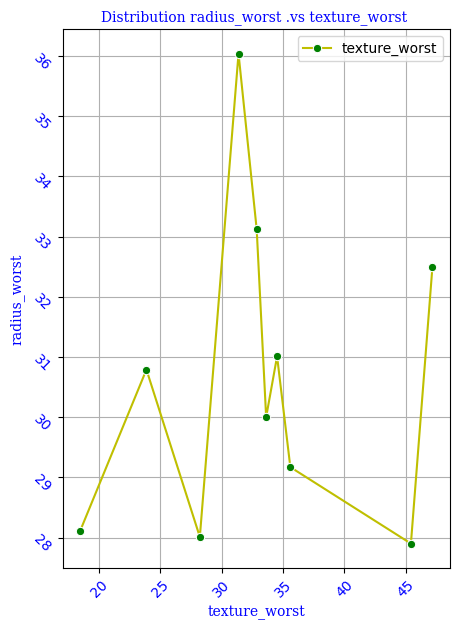

In [33]:
# observation  smoothness_worst .vs area_worst

f2={"family":"serif","size":10,"color":"b"}
plt.figure(figsize=(5,7))
plt.title("Distribution area_worst .vs smoothness_worst",fontdict=f2)

top1=data.groupby("area_worst")["smoothness_worst"].mean().sort_values(ascending=False).head(10)
sns.lineplot(x=top1.index,y=top1.values,color="r",marker="o",mfc="y",label="smoothness_worst through area_worst")

plt.xticks(rotation=45,color="b")
plt.xlabel("area_worst",fontdict=f2)
plt.ylabel("smoothness_worst",fontdict=f2)
plt.yticks(rotation=-45,color="b")
plt.grid(True)
plt.show()


# Distribution radius_worst .vs texture_worst :


plt.figure(figsize=(5,7))
plt.title("Distribution radius_worst .vs texture_worst ",fontdict=f2)

top1=data.groupby("texture_worst")["radius_worst"].mean().sort_values(ascending=False).head(10)
sns.lineplot(x=top1.index,y=top1.values,color="y",marker="o",mfc="g",label="texture_worst")

plt.xticks(rotation=45,color="b")
plt.xlabel("texture_worst",fontdict=f2)
plt.ylabel("radius_worst",fontdict=f2)
plt.yticks(rotation=-45,color="b")
plt.grid(True)
plt.show()


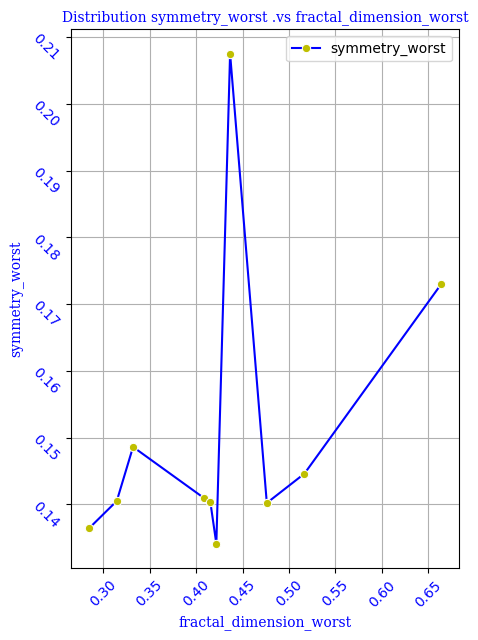

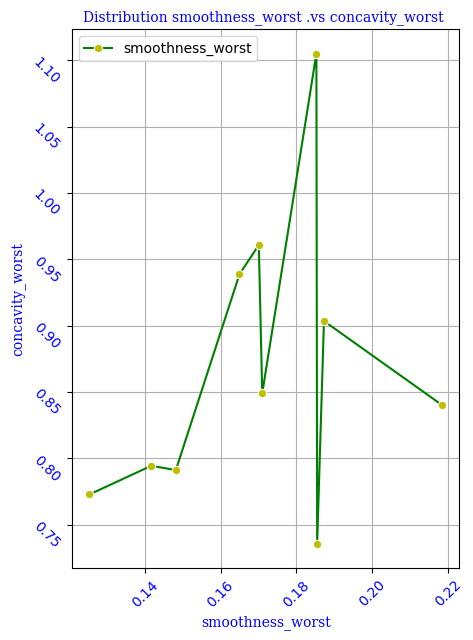

In [34]:
# observation  symmetry_worst .vs fractal_dimension_worst

f2={"family":"serif","size":10,"color":"b"}
plt.figure(figsize=(5,7))
plt.title("Distribution symmetry_worst .vs fractal_dimension_worst",fontdict=f2)

top1=data.groupby("symmetry_worst")["fractal_dimension_worst"].mean().sort_values(ascending=False).head(10)
sns.lineplot(x=top1.index,y=top1.values,color="b",marker="o",mfc="y",label="symmetry_worst")

plt.xticks(rotation=45,color="b")
plt.xlabel("fractal_dimension_worst",fontdict=f2)
plt.ylabel("symmetry_worst",fontdict=f2)
plt.yticks(rotation=-45,color="b")
plt.grid(True)
plt.show()


# Distribution smoothness_worst .vs concavity_worst :


plt.figure(figsize=(5,7))
plt.title("Distribution smoothness_worst .vs concavity_worst ",fontdict=f2)

top1=data.groupby("smoothness_worst")["concavity_worst"].mean().sort_values(ascending=False).head(10)
sns.lineplot(x=top1.index,y=top1.values,color="g",marker="o",mfc="y",label="smoothness_worst")

plt.xticks(rotation=45,color="b")
plt.xlabel("smoothness_worst",fontdict=f2)
plt.ylabel("concavity_worst",fontdict=f2)
plt.yticks(rotation=-45,color="b")
plt.grid(True)
plt.show()

In [35]:
data.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


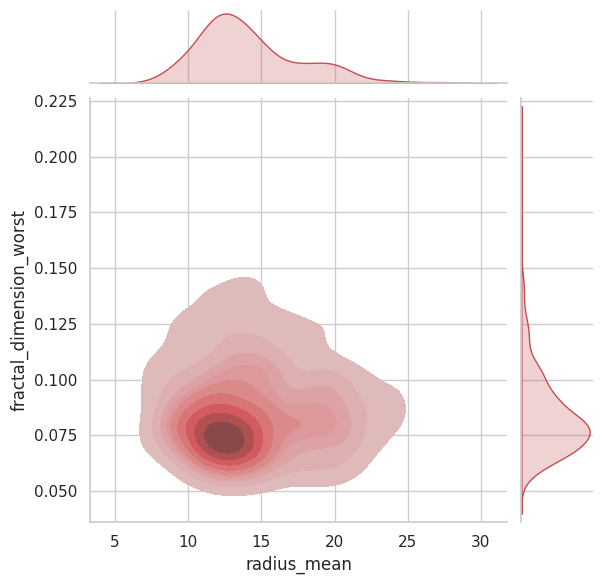

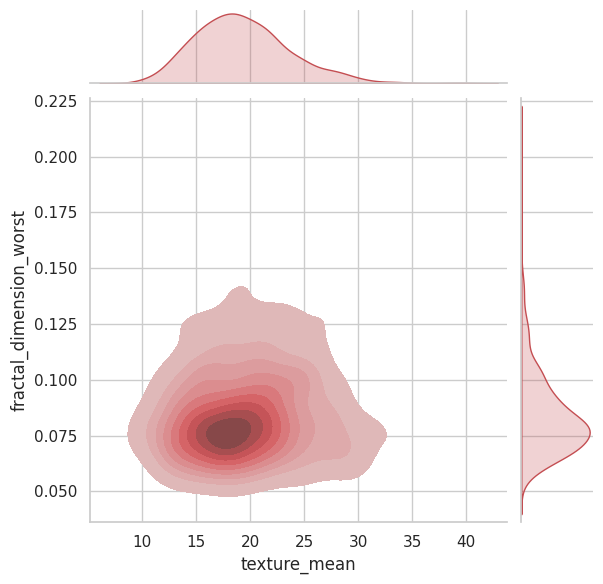

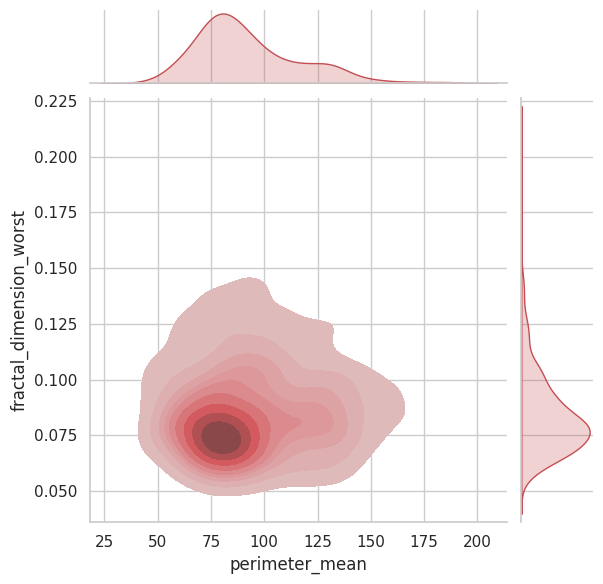

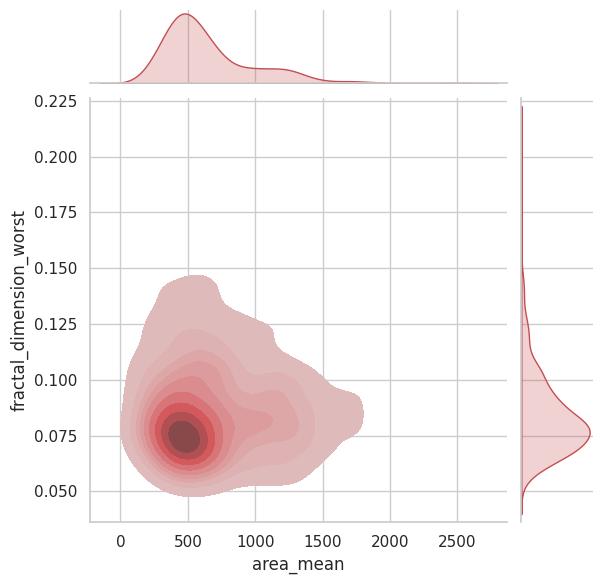

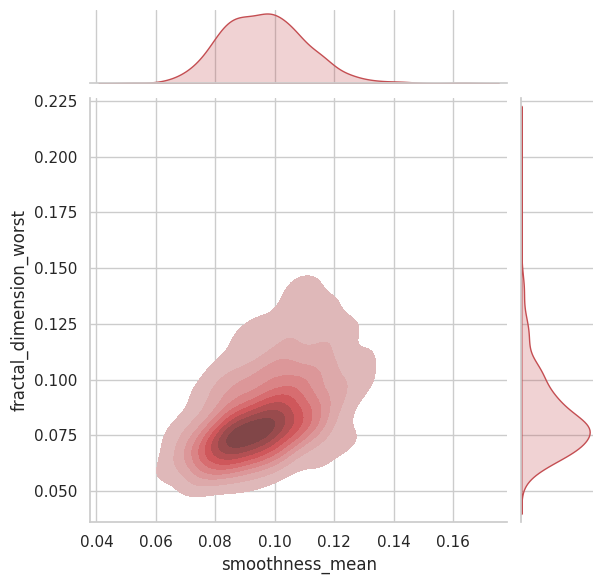

...

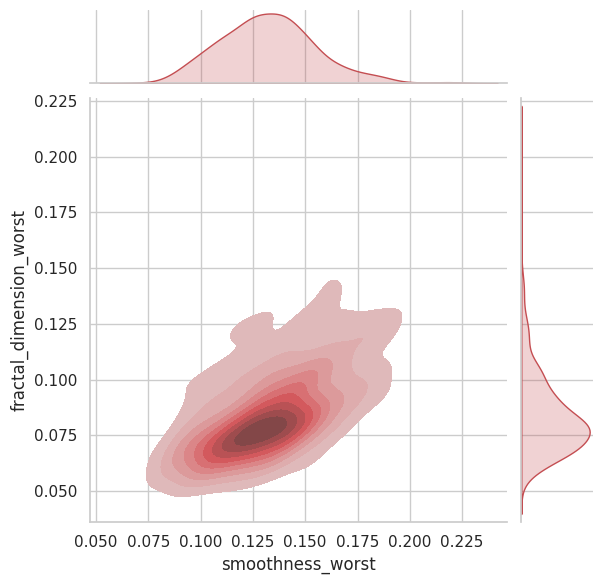

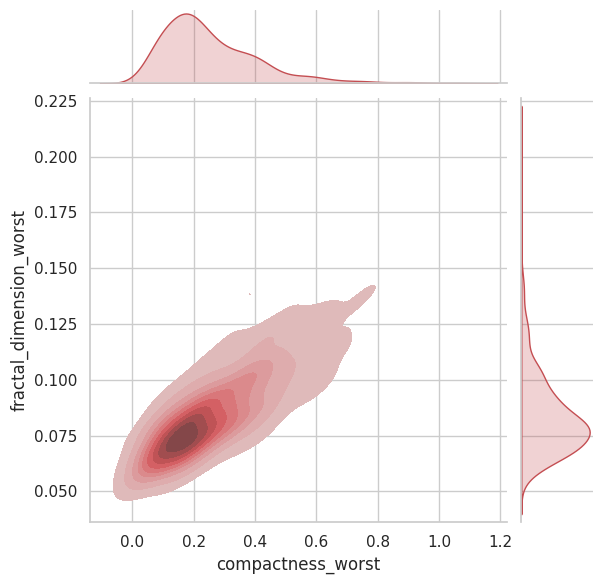

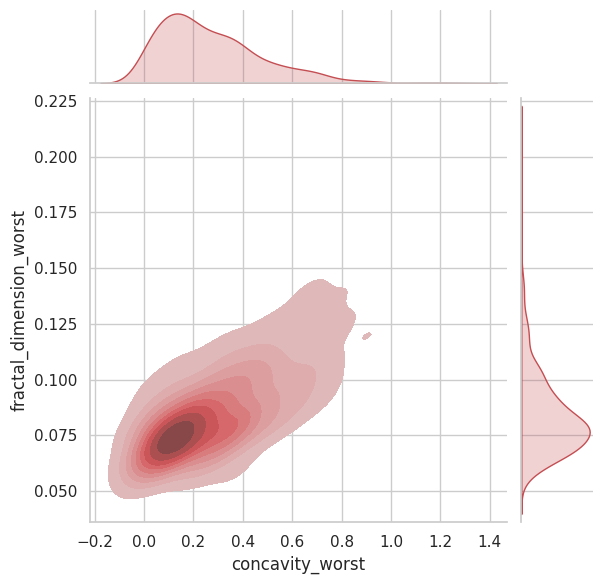

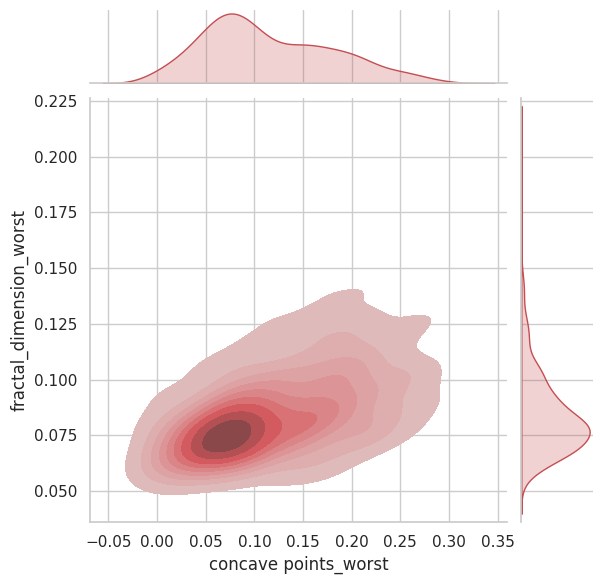

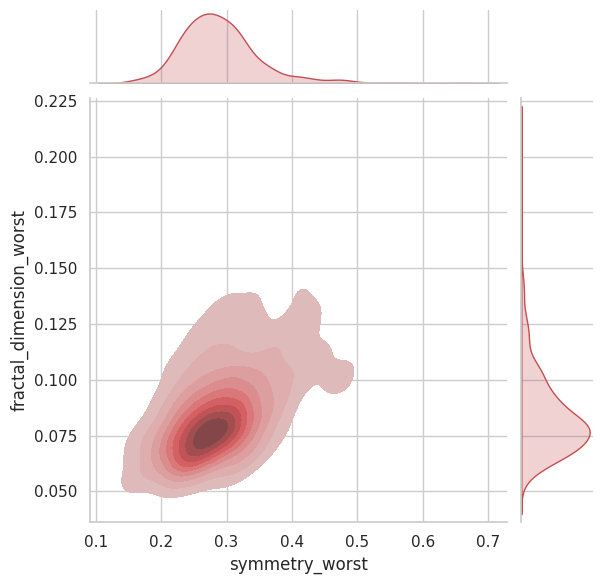

In [36]:
for col in data.select_dtypes("number"):
    if col !="fractal_dimension_worst":
       with sns.axes_style("white"):
           sns.set(style="whitegrid")  
           sns.set_palette("coolwarm")    
           sns.jointplot(x=data[col],y=data["fractal_dimension_worst"],kind="kde",fill=True,color="r")

array([[<Axes: title={'center': 'radius_mean'}>,
        <Axes: title={'center': 'texture_mean'}>,
        <Axes: title={'center': 'perimeter_mean'}>,
        <Axes: title={'center': 'area_mean'}>,
        <Axes: title={'center': 'smoothness_mean'}>],
       [<Axes: title={'center': 'compactness_mean'}>,
        <Axes: title={'center': 'concavity_mean'}>,
        <Axes: title={'center': 'concave points_mean'}>,
        <Axes: title={'center': 'symmetry_mean'}>,
        <Axes: title={'center': 'fractal_dimension_mean'}>],
       [<Axes: title={'center': 'radius_se'}>,
        <Axes: title={'center': 'texture_se'}>,
        <Axes: title={'center': 'perimeter_se'}>,
        <Axes: title={'center': 'area_se'}>,
        <Axes: title={'center': 'smoothness_se'}>],
       [<Axes: title={'center': 'compactness_se'}>,
        <Axes: title={'center': 'concavity_se'}>,
        <Axes: title={'center': 'concave points_se'}>,
        <Axes: title={'center': 'symmetry_se'}>,
        <Axes: title={'ce

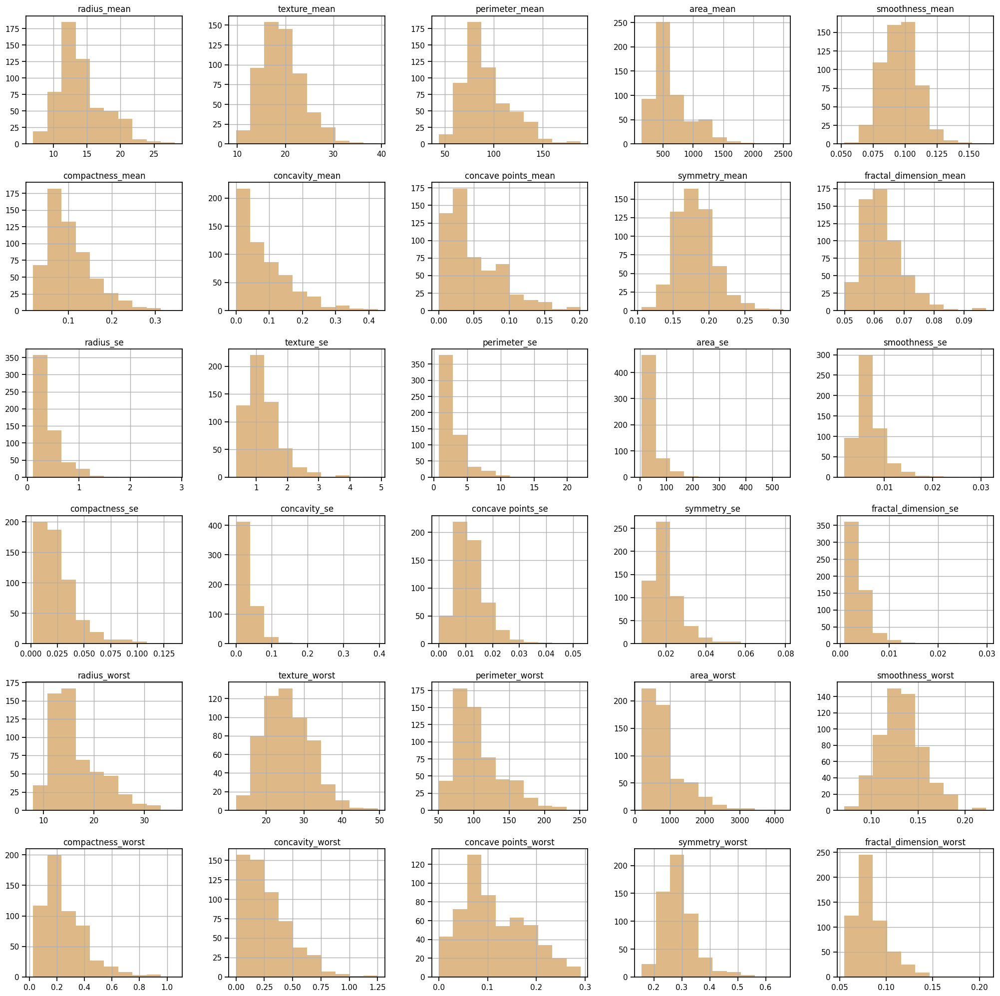

In [37]:
# plot the histgram:
data.hist(figsize=(25,25),color="#DEB887")

In [38]:
# observe for the Numeric_data
plt.figure(figsize=(100, 100), dpi=120)
sns.set(style="whitegrid")  # Set the plot style
sns.set_palette("coolwarm")    # Set the color palette
sns.pairplot(data.select_dtypes(include="float64"))

<Figure size 12000x12000 with 0 Axes>

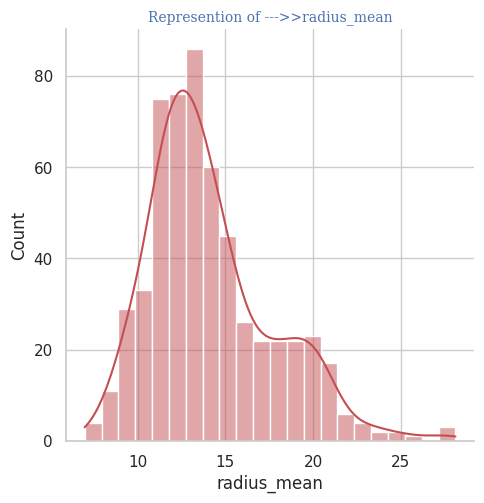

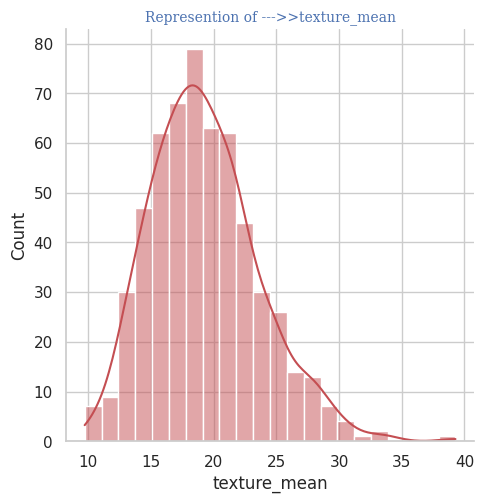

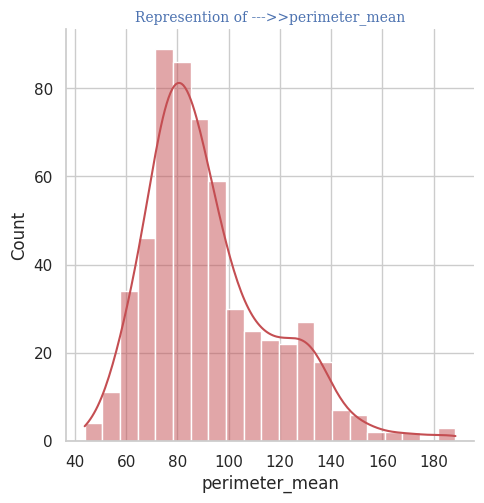

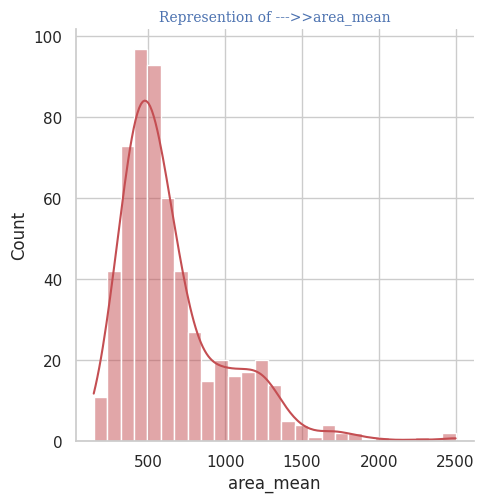

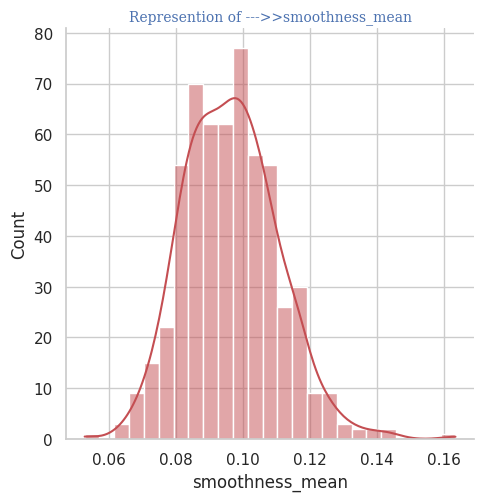

...

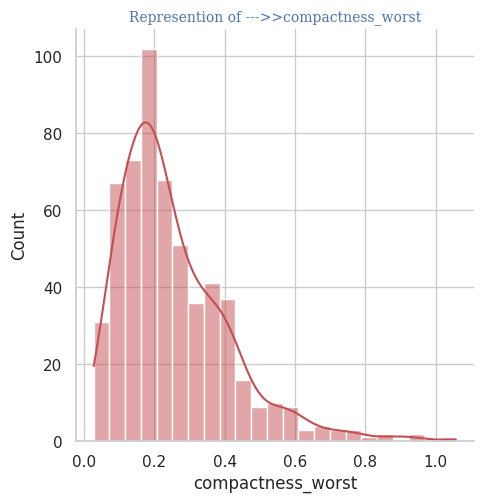

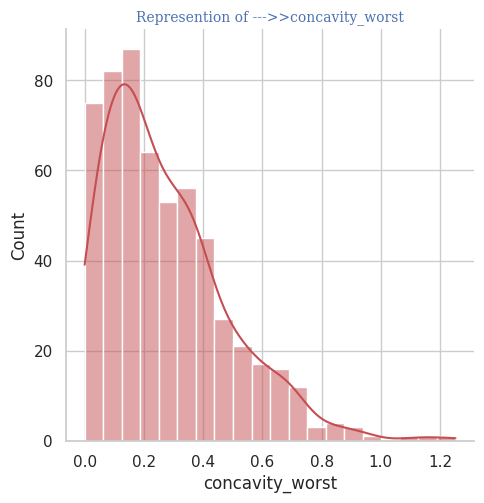

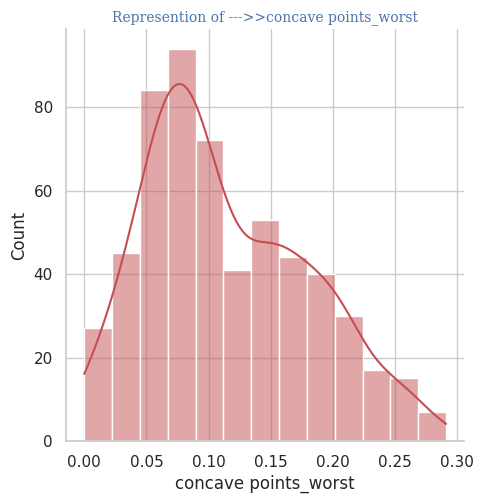

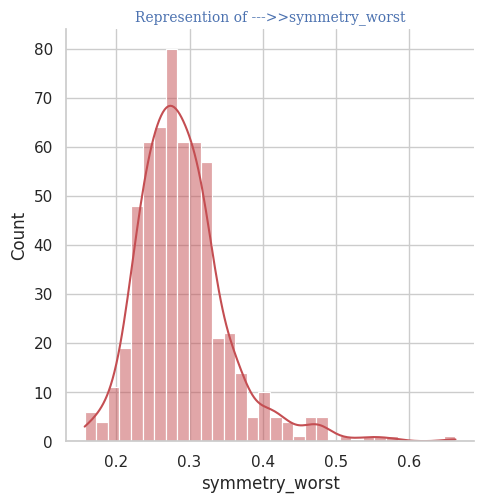

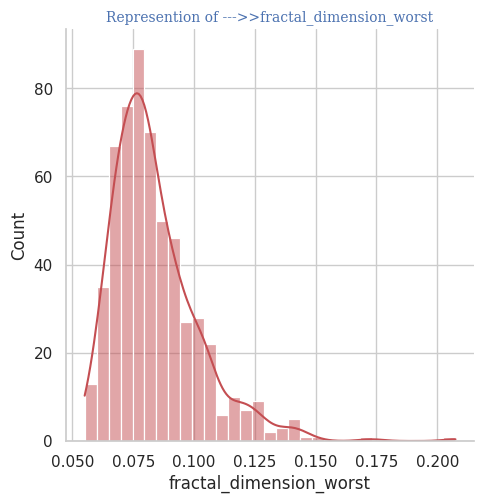

In [39]:
for col in data.select_dtypes("number").columns:
    sns.displot(data[col],kde=True,color="r",label=col)
    sns.set(style="whitegrid")  # Set the plot style
    sns.set_palette("coolwarm")    # Set the color palette
    plt.title("Represention of --->>"+col,fontdict=f2)

## Split Data for Classification :


<div style="border: 5px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

<p> &bull; i split data into x_class & y_class </p> 

<p> &bull; x_class : refer into all Data Except Target (diagnosis)</p> 

<p> &bull; y_class : refer into Target (diagnosis)</p> 

<p> &bull; then , iused train_test_split method to divide data into test , train</p> 
</div>


In [40]:

# split the data int train & test :

x_class,y_clss=make_classification(n_samples=100,random_state=42)

x_class=data.drop(columns="diagnosis",axis=1)
y_class=data["diagnosis"]

In [41]:
# train split of the Data
x_train,x_test,y_train,y_test=train_test_split(x_class,y_class,test_size=0.2,random_state=42)
print("x_train shape : ",x_train.shape)
print("x_test shape : ",x_test.shape)
print("y_train shape : ",y_train.shape)

x_train shape :  (455, 30)

x_test shape :  (114, 30)

y_train shape :  (455,)


## Data Processing :







<div style="border: 5px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

<p>&bull; I used pipline method to make strong structure for processing for both scaler & dummies </p>
<p> &bull; i used OneHotEncoder  method from to convert any object/Categorical data into Numerical </p> 

<p> &bull; Also i used Standard Scaler on this Data</p> 

</div>

## Create processing pipeline :

In [42]:
# Define the numeric features and categorical features
categorical_features =x_train.select_dtypes("object").columns
numeric_features = x_train.select_dtypes("number").columns

# Print the features to ensure they are correctly identified
print("Categorical Features:", categorical_features)
print("Numeric Features:", numeric_features)

# Create preprocessing pipelines for both numeric and categorical data
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Combine preprocessing steps
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

 

Categorical Features: Index([], dtype='object')

Numeric Features: Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',

       'smoothness_mean', 'compactness_mean', 'concavity_mean',

       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',

       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',

       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',

       'fractal_dimension_se', 'radius_worst', 'texture_worst',

       'perimeter_worst', 'area_worst', 'smoothness_worst',

       'compactness_worst', 'concavity_worst', 'concave points_worst',

       'symmetry_worst', 'fractal_dimension_worst'],

      dtype='object')


## Bulding Five Traditional Machine Learning Modules :

<div style="border: 5px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">


<p> &bull; I define all of this models :  </p>                            

<p> &bull; KNeighborsClassifier (KNN) </p> 
                                                             
<p> &bull; RandomForestClassiﬁer </p> 

<p> &bull; Decision Tree Classiﬁer </p> 

<p> &bull; Logistic Regression </p> 

<p> &bull; Naive Bayes</p>

<p> &bull; After Defination of all this models , I creat ea pipeline for each model </p>
</div>



In [43]:
## Define the models :

lg=LogisticRegression(random_state=42)

DT=DecisionTreeClassifier(max_depth=5,random_state=42)

RF=RandomForestClassifier(random_state=42)

KNN =KNeighborsClassifier(n_neighbors=2)

NB=GaussianNB()
        

## Create Pipeline for every  model  :

In [44]:
# Create the pipelines for each model

pipeline_knn = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('knn', KNN)
])

pipeline_random_forest = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('random_forest', RF)
])

pipeline_decision_tree = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('decision_tree', DT)
])

pipeline_logistic_regression = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('logistic_regression', lg)
])

pipeline_naive_bayes = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('naive_bayes', NB)
])



In [45]:
# Train the models using the pipelines

pipeline_knn.fit(x_train, y_train)
pipeline_random_forest.fit(x_train, y_train)
pipeline_decision_tree.fit(x_train, y_train)
pipeline_logistic_regression.fit(x_train, y_train)
pipeline_naive_bayes.fit(x_train, y_train)


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se'...
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')),
                                                 ('cat',
                         

Model: KNeighborsClassifier(n_neighbors=2)

Model Accuracy: 94.74%



Classification Report:

              precision    recall  f1-score   support



           B       0.93      0.99      0.96        71

           M       0.97      0.88      0.93        43



    accuracy                           0.95       114

   macro avg       0.95      0.93      0.94       114

weighted avg       0.95      0.95      0.95       114



--------------------------------------------------


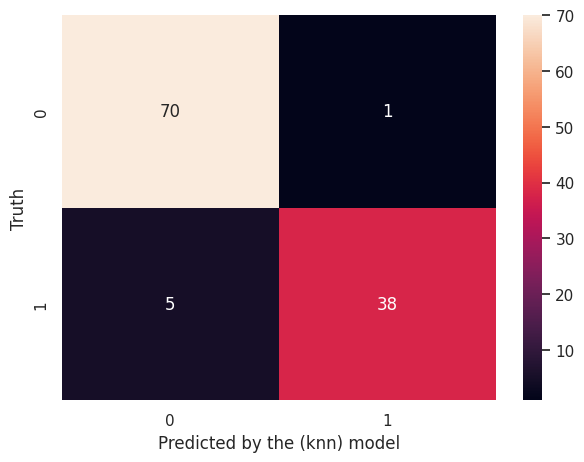

Model: RandomForestClassifier(random_state=42)

Model Accuracy: 96.49%



Classification Report:

              precision    recall  f1-score   support



           B       0.96      0.99      0.97        71

           M       0.98      0.93      0.95        43



    accuracy                           0.96       114

   macro avg       0.97      0.96      0.96       114

weighted avg       0.97      0.96      0.96       114



--------------------------------------------------


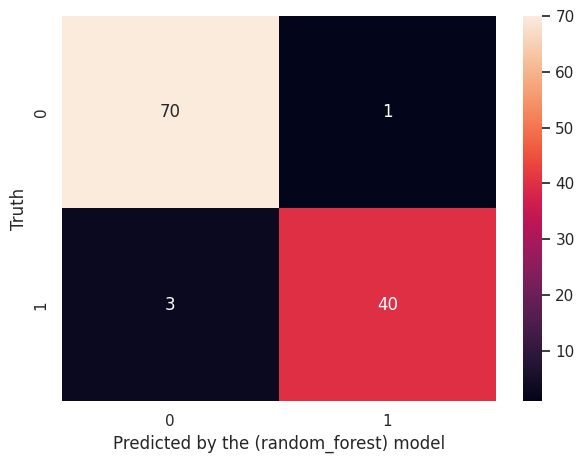

Model: DecisionTreeClassifier(max_depth=5, random_state=42)

Model Accuracy: 94.74%



Classification Report:

              precision    recall  f1-score   support



           B       0.96      0.96      0.96        71

           M       0.93      0.93      0.93        43



    accuracy                           0.95       114

   macro avg       0.94      0.94      0.94       114

weighted avg       0.95      0.95      0.95       114



--------------------------------------------------


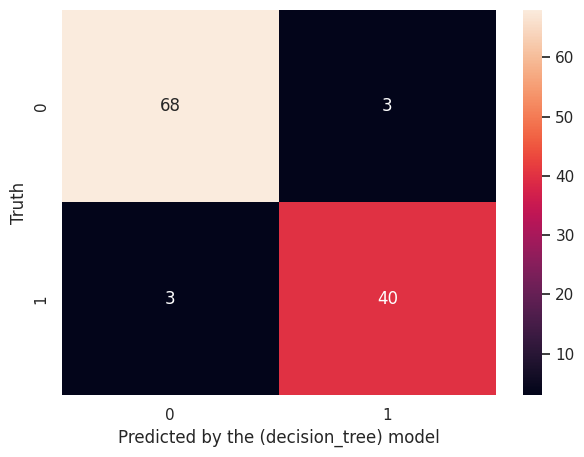

Model: LogisticRegression(random_state=42)

Model Accuracy: 97.37%



Classification Report:

              precision    recall  f1-score   support



           B       0.97      0.99      0.98        71

           M       0.98      0.95      0.96        43



    accuracy                           0.97       114

   macro avg       0.97      0.97      0.97       114

weighted avg       0.97      0.97      0.97       114



--------------------------------------------------


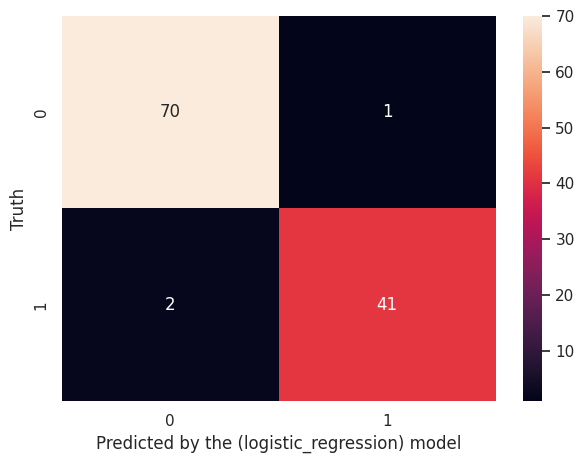

Model: GaussianNB()

Model Accuracy: 96.49%



Classification Report:

              precision    recall  f1-score   support



           B       0.96      0.99      0.97        71

           M       0.98      0.93      0.95        43



    accuracy                           0.96       114

   macro avg       0.97      0.96      0.96       114

weighted avg       0.97      0.96      0.96       114



--------------------------------------------------


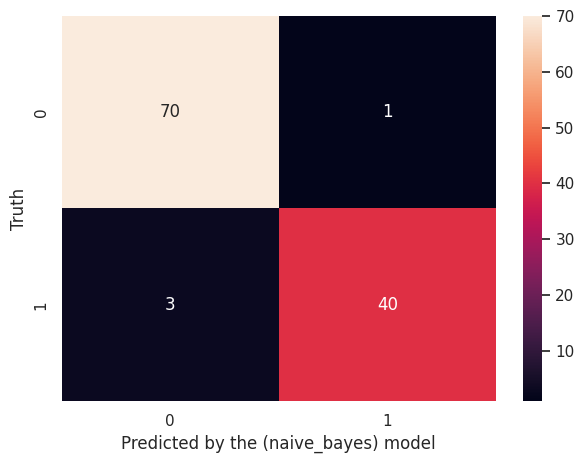

In [46]:
# Define a function to evaluate a pipeline
def evaluate_pipeline(pipeline, X_test, y_test):
    y_pred = pipeline.predict(X_test)
    acc = pipeline.score(X_test, y_test)
    cm = confusion_matrix(y_test, y_pred)
    classif_report = classification_report(y_test, y_pred)
    
    print(f"Model: {pipeline.steps[-1][1]}")
    print(f"Model Accuracy: {acc * 100:.2f}%")
    print("\nClassification Report:")
    print(classif_report)
    print("-" * 50)
    
    # Plot the confusion matrix
    plt.figure(figsize=(7, 5))
    sns.heatmap(cm, annot=True)
    plt.xlabel(f"Predicted by the ({pipeline.steps[-1][0]}) model")
    plt.ylabel('Truth')
    plt.show()

# Evaluate each pipeline
evaluate_pipeline(pipeline_knn, x_test, y_test)
evaluate_pipeline(pipeline_random_forest, x_test, y_test)
evaluate_pipeline(pipeline_decision_tree, x_test, y_test)
evaluate_pipeline(pipeline_logistic_regression, x_test, y_test)
evaluate_pipeline(pipeline_naive_bayes, x_test, y_test)

## Bulding Artifical Neural Network (ANN MODEL): 


<div style="border: 5px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

                             
<p> &bull; at first ,Input Layer: The input shape is x_train.shape[1] -> Refer into Number of Dataset Featurese Except TARGET </p> 

<p> &bull; Hidden Layers: </p> 

<p> &bull; Layer 1: Dense(64, activation="relu") with L2 regularization and Dropout(0.3).</p> 

<p> &bull; Layer 2: Dense(128, activation="relu") with L2 regularization and Dropout(0.4 </p> 

<p> &bull; Layer 3: Dense(256, activation="relu") with L2 regularization and Dropout(0.5). </p> 

<p> &bull; Layer 4: Dense(128, activation="relu") with L2 regularization and Dropout(0.4). </p> 

<p> &bull; Layer 5: Dense(64, activation="relu") with L2 regularization and Dropout(0.3).</p> 

<p> &bull; Output Layer: Dense(1, activation="sigmoid") with L2 regularization </p> 

<p> &bull; Summary : </p>

<p> &bull;Simplified Architecture: Reduced the number of units in the dense layers to avoid overfitting.</p>

<p>&bull;Batch Normalization: Retained to stabilize the learning process.</p>

<p>&bull;Dropout: Adjusted dropout rates to balance regularization and information preservation.</p>

<p>&bull;L2 Regularization: Retained to prevent overfitting</p>

<p> &bull; Model Training:  </p>

<p> &bull; i train the model on 200 epochs & used Callbacks to stop the model training at 98% accuracy   </p>

<p> &bull; Also rained the model with 100 batch_size ,validation_split= 0.1  </p>

<p> &bull; Model Compile:  </p>

<p> &bull; i used Adam optimizer with learning_rate=0.001 </p>

<p> &bull; Also , used Binarycrossentroy with loss  </p>

</div>

In [47]:
import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense,Input,Dropout,BatchNormalization
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import Callback

2024-09-06 20:34:38.588729: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.

2024-09-06 20:34:38.590124: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.

2024-09-06 20:34:38.617069: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.

2024-09-06 20:34:38.617862: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.

To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.

2024-09-06 20:34:39.640026: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warnin

In [48]:
# Define a Callback class that stops training once accuracy reaches 98%

class myCallback(Callback):
  def on_epoch_end(self, epoch, logs={}):
    if(logs.get('accuracy')>0.98):
      print("\n Reached  98 % accuracy so cancelling training!")
      self.model.stop_training = True

In [49]:
# Standardize the features
scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_test = scaler.transform(x_test)

# Encode the target variable
label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)
y_test_encoded = label_encoder.transform(y_test)

In [50]:
# Define the model

model_r = Sequential([
    Dense(units=64, input_shape=(x_train.shape[1],), activation="relu", kernel_regularizer=l2(0.01)),
    BatchNormalization(),
    Dropout(0.3),
    
    Dense(units=128, activation="relu", kernel_regularizer=l2(0.01)),
    BatchNormalization(),
    Dropout(0.4),
    
    Dense(units=256, activation="relu", kernel_regularizer=l2(0.01)),
    BatchNormalization(),
    Dropout(0.5),
    
    Dense(units=128, activation="relu", kernel_regularizer=l2(0.01)),
    BatchNormalization(),
    Dropout(0.4),
    
    Dense(units=64, activation="relu", kernel_regularizer=l2(0.01)),
    BatchNormalization(),
    Dropout(0.3),
    
    Dense(units=1, activation="sigmoid", kernel_regularizer=l2(0.01)),
])


model_r.summary()

# Compile the model
model_r.compile(
    loss="binary_crossentropy",
    optimizer="adam",
    metrics=["accuracy"]
)


callbacks =myCallback()

print("\n Model_Training:")

history = model_r.fit(x_train, y_train_encoded, epochs=200, batch_size=100, validation_split=0.1, callbacks=callbacks)
history

Model: "sequential"

_________________________________________________________________

 Layer (type)                Output Shape              Param #   


 dense (Dense)               (None, 64)                1984      

                                                                 

 batch_normalization (Batch  (None, 64)                256       

 Normalization)                                                  

                                                                 

 dropout (Dropout)           (None, 64)                0         

                                                                 

 dense_1 (Dense)             (None, 128)               8320      

                                                                 

 batch_normalization_1 (Bat  (None, 128)               512       

 chNormalization)                                                

                                                                 

 dropout_1 (Dropout)         (None, 128)

2024-09-06 20:34:40.003529: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355

2024-09-06 20:34:40.003916: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1960] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.

Skipping registering GPU devices...


5/5 [==============================] - 1s 39ms/step - loss: 6.4746 - accuracy: 0.4988 - val_loss: 6.1277 - val_accuracy: 0.8478

Epoch 2/200

5/5 [==============================] - 0s 6ms/step - loss: 6.1521 - accuracy: 0.6748 - val_loss: 6.0152 - val_accuracy: 0.8913

Epoch 3/200

5/5 [==============================] - 0s 6ms/step - loss: 5.8605 - accuracy: 0.7897 - val_loss: 5.9075 - val_accuracy: 0.8696

Epoch 4/200

5/5 [==============================] - 0s 6ms/step - loss: 5.7416 - accuracy: 0.8093 - val_loss: 5.7988 - val_accuracy: 0.8696

Epoch 5/200

5/5 [==============================] - 0s 5ms/step - loss: 5.6082 - accuracy: 0.8533 - val_loss: 5.6918 - val_accuracy: 0.8696

Epoch 6/200

5/5 [==============================] - 0s 6ms/step - loss: 5.5310 - accuracy: 0.8631 - val_loss: 5.5859 - val_accuracy: 0.8696

Epoch 7/200

5/5 [==============================] - 0s 6ms/step - loss: 5.4230 - accuracy: 0.8606 - val_loss: 5.4851 - val_accuracy: 0.8913

Epoch 8/200

5/5 [=======

In [51]:
# predict on the model:
y_p=model_r.predict(x_test)
y_p[:10]

4/4 [==============================] - 0s 1ms/step


array([[0.05454375],
       [0.97800857],
       [0.8848548 ],
       [0.02464976],
       [0.0250378 ],
       [0.9992173 ],
       [0.99641216],
       [0.19626358],
       [0.14819294],
       [0.03562856]], dtype=float32)

In [52]:
# compute min & max in the y_prediction:
print(f"the min_value for prediction --->> {np.min(y_p)} \n the max_value for prediction --->>> {np.max(y_p)} ")

the min_value for prediction --->> 0.02179468609392643 

 the max_value for prediction --->>> 0.9995556473731995 


In [53]:
#Evalute the ANN_model:
model_r.evaluate(x_test,y_test_encoded,verbose=2)

4/4 - 0s - loss: 2.1903 - accuracy: 0.9474 - 14ms/epoch - 3ms/step


[2.190288543701172, 0.9473684430122375]

## Save & Load the Model :

In [54]:
# Save the model
model_r.save('ANN_model.h5')

# Load the trained model
model_r = tf.keras.models.load_model('ANN_model.h5')

## Visualization of Artifcal Neural Network Model :

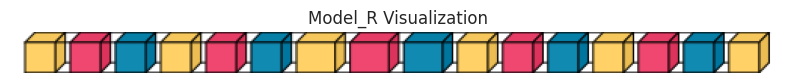

In [55]:
import visualkeras
from PIL import Image

# Save the visualization as an image file
visualization_path = 'model_visualization.png'
visualkeras.layered_view(model_r).save(visualization_path)

# Display the image using matplotlib
img = Image.open(visualization_path)
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.title("Model_R Visualization")
plt.axis('off')
plt.show()

## Results Train :

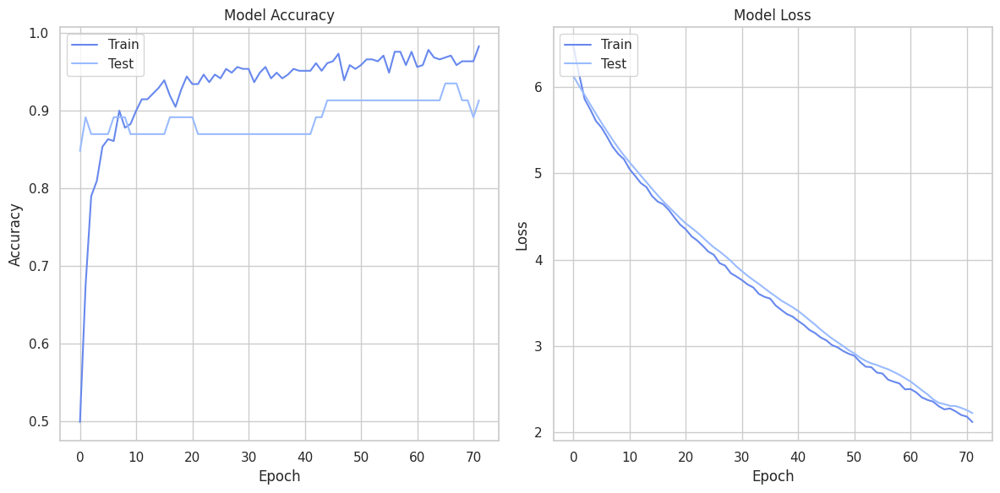

In [56]:
# Plotting training history (accuracy and loss)
plt.figure(figsize=(12, 6))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Test'], loc='upper left')

plt.tight_layout()
plt.show()

## Results :

<div style="border: 5px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

                             
<p> &bull; Model : LogisticRegression  </p> 
<p> &bull; model_accuracy: 97.37%  </p> 

<p> --------------------------------------------------------------------------------------  </p> 

<p> &bull; Model : DecisionTreeClassifier  </p> 
<p> &bull; model_accuracy:   94.74% </p> 

<p> --------------------------------------------------------------------------------------  </p> 

<p> &bull; Model : RandomForestClassifier  </p> 
<p> &bull; model_accuracy: 96.49%  </p> 

<p> --------------------------------------------------------------------------------------  </p> 

<p> &bull; Model : knn_classifier   </p> 
<p> &bull; model_accuracy: 94.74% </p> 

<p> --------------------------------------------------------------------------------------  </p> 

<p> &bull; Model : GaussianNB </p> 
<p> &bull; model_accuracy:96.49% </p> 

<p> --------------------------------------------------------------------------------------  </p> 
<p> &bull; Model :Artifcal Neural Network (ANN)   </p> 
<p> &bull; loss:1.9519463777542114,    </p> 
<p> &bull; model_accuracy:0.9736841917037964   </p> 
<p> --------------------------------------------------------------------------------------  </p> 

</div>

## See the best model :

<div style="border: 5px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

                             
<p> &bull; At first we known that Every model has Advantages & disadvantages , so we cant say that there are model is the best at all .  </p> 
<p> &bull; but , in this Dataset , we will detect the best model based on : </p> 
<p> &bull; highest R^2 : CoffientDetermination   </p> 
<p> &bull;MSE : lowest mean square Error  </p>
<p> &bull; Comparing  Metrics   </p>
<p> &bull; After Comparing All of these condation the Best model in Traditional Ml-models : LogisticRegression </p>

<p> &bull; And in the Artifical Neural Network we can say is the best & more powerful model </p>

</div>


## Conclusion :














<div style="border: 5px solid red; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">


    
<p>&bull; in the Conclusion im whish that you could understand how to build  a Artifical  Neural Network (ANN) Model .Classification , Thank you for following my Notebooks .</p>




<p>&bull; Thank you for reading this notebook! If you found this content useful, please consider giving it an upvote.</p>




<p>&bull; Your support is greatly appreciated! .</p>




<p>&bull; Kaggle: Your Home for Data Science</p>




<p>&bull; <a href="https://www.kaggle.com/abdalrhamnhebishy" target="_blank">Kaggle profile</a>.</p>



<p>&bull;  AbdalRhman Hebishy , DataScientist||Machine learning||Deeplearning Engineer .</p>
   

</div>


<img src="https://t4.ftcdn.net/jpg/04/00/26/99/360_F_400269908_gDF8JR2ctyHWiL1kww6WEWBerRzD5MBb.jpg" alt="My Image">